# Colab containing code for "Evolving Three Dimension (3D) Abstract Art: Fitting Concepts by Language"

This colab notebook anonymously contains the code for "Evolving Three Dimension (3D) Abstract Art: Fitting Concepts by Language". For more information about this work, see the website https://es3dart.github.io/.

This notebook is best running on a Colab Pro+ one with better GPUs (say A100).

In [ ]:
! nvidia-smi

Tue Feb 14 07:29:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   30C    P0    50W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Preamble

In [ ]:
#@markdown We need to put a lot of 3D rendering in a separate module.
#@markdown This is due to the fact that we want to tolerate errors in mitsuba 3 by running it on a delicated process and restart if things are wrong. The multi-processing in Python requires such separation.

#@markdown To do so, we keep the content of the said separate module on `es_lib.py`.

ES1_LIB_CONTENT = '''
from collections import namedtuple
import os
import signal
import sys
import time

from PIL import Image

import numpy as np
from numpy.random import default_rng

# Note that mitsuba/drji/jax are lazy imported.
# This behavior enables controlling their behaviors (say through os.environ) before they are loaded.

# ------ utils --------
def is_notebook() -> bool:
    try:
        shell = get_ipython().__class__.__name__
        if shell == 'ZMQInteractiveShell':
            return True   # Jupyter notebook or qtconsole
        elif shell == 'TerminalInteractiveShell':
            return False  # Terminal running IPython
        else:
            return False  # Other type (?)
    except NameError:
        return False      # Probably standard Python interpreter
    
if not is_notebook():  # is case of running in cmd, do nothing when display() is invoked.
    def display(*arg, **kwargs):
        pass

def normalize(v):
    assert len(v.shape) == 2
    N = v.shape[0]
    ch = v.shape[1]
    v = v.copy()
    for i in range(ch):
        _v = v[:, i]
        _v = (_v - _v.min()) / (_v.max() - _v.min())
        v[:, i] = _v
    return v

def normalize_1d(v):
    return np.squeeze(normalize(np.expand_dims(v, axis=-1)), axis=-1)

# ------- Scenes ----

mitsuba_variant = 'cuda_ad_rgb' # try using GPU for renderin

def scene0_render_fn(
    param: dict, 
    render_hp: dict,
):
    # lazy import mitsuba & set variant
    import drjit as dr
    import mitsuba as mi
    mi.set_variant(mitsuba_variant)
    
    # unpackfrom param & verify
    triangle_N = param['triangle_N']
    vertex_N = triangle_N * 3
    triangle_vert = param['triangle_vert']
    triangle_color = param['triangle_color']
    normalization_spec = param['normalization_spec']
    normalize_vert = param['normalize_vert']
    learnable_transparency = param['learnable_transparency']
    triangle_transparency = param['triangle_transparency']
    
    assert triangle_N > 0
    vertex_N = triangle_N * 3
    assert triangle_vert.shape == (vertex_N, 3)
    assert triangle_color.shape == (triangle_N, 3)
    if learnable_transparency:
        assert triangle_transparency.shape == (triangle_N, 1)
    else:
        assert triangle_transparency is None
    
    # unpack from render_hp & verify
    sensor = render_hp.get('sensor', None) or \
        scene0_sensor_fn(
            theta = render_hp['sensor_param']['theta'], 
            phi = render_hp['sensor_param']['phi'],
            width = render_hp['sensor_param'].get('width', None),
            height = render_hp['sensor_param'].get('height', None),
            r = render_hp['sensor_param'].get('r', None),
            fov = render_hp['sensor_param'].get('fov', None),
        )
    
    save_aux = render_hp.get('save_aux', False)
    render_kwargs = render_hp.get('render_kwargs', False)
    
    tmp_dir = f'/dev/shm/mitsuba3/es1/{os.getpid()}'
    os.makedirs(tmp_dir, exist_ok=True)
    
    render_kwargs = render_kwargs or dict()
    
    # real work
    
    if normalize_vert:
        triangle_vert = normalize(triangle_vert)
    else:
        from jax import numpy as jnp
        x = triangle_vert
        x = jnp.array(x)
        x = x * 20.0
        x = 1/(1 + jnp.exp(-x))
        x = np.array(x, dtype=np.float32)
        triangle_vert = x
        
    triangle_color = normalize(triangle_color)
    if learnable_transparency:
        triangle_transparency = normalize(triangle_transparency)
        
    for spec in normalization_spec:
        verb, args = spec
        if verb == 'triangle_scale':
            scale = args[0]
            for i in range(triangle_N):
                center = (triangle_vert[i*3] + triangle_vert[i*3+1] + triangle_vert[i*3+2])/3.0
                for j in range(3):
                    triangle_vert[i*3+j] = center + (triangle_vert[i*3+j] - center) * scale
        elif verb == 'vertex_grid':
            grid_div = args[0] 
            # round to nearest of 0, 1/grid_div, 2/grid_div ... grid_div/grid_div=1.
            triangle_vert = np.rint(triangle_vert * grid_div) * 1.0 / grid_div
            
        else:
            print(f'unknown {spec} in normalization_spec. skip.')
    
    triangle_vert = triangle_vert * 2 - 1.0 # [0,1] -> [-1,1]
    vertex_pos = mi.Point3f(triangle_vert[:,0], triangle_vert[:,1], triangle_vert[:,2])
    
    face_indices = mi.Vector3u(
        np.arange(0, triangle_N) * 3,
        np.arange(0, triangle_N) * 3 + 1,
        np.arange(0, triangle_N) * 3 + 2,
    )
    
    mesh = mi.Mesh(
        "triangles",
        vertex_count= vertex_N ,
        face_count=triangle_N,
        has_vertex_normals=False,
        has_vertex_texcoords=False,
    )
    mesh_params = mi.traverse(mesh)
    mesh_params["vertex_positions"] = dr.ravel(vertex_pos)
    mesh_params["faces"] = dr.ravel(face_indices)
    mesh_params.update();
    
    mesh_fn = f'{tmp_dir}/es0-triangles.ply'
    mesh.write_ply(mesh_fn)
    
    bsdf_d = {
        'type': 'twosided',
        'reflectance':{
            'type': 'diffuse',
            'reflectance': {
                "type": "mesh_attribute",
                "name": "face_color",  
            }
        }
    }
    bsdf_td = {
        'type': 'thindielectric',
        'int_ior': 'bk7',
        'ext_ior': 'air'
    }
    bsdf_two = {
        'type': 'blendbsdf',
        'weight': (
            param['transparency'] 
            if not learnable_transparency
            else {
                'type': 'mesh_attribute',
                'name': 'face_transparency',
            }
        ),
        'bsdf_0': bsdf_d,
        'bsdf_1': bsdf_td,
    }
    bsdf = bsdf_two
    mesh_colored = mi.load_dict({
        'type': 'ply',
        'filename': mesh_fn,
        'bsdf': bsdf,
    })
    
    mesh_colored.add_attribute(
        "face_color", 3, [0] * mesh_colored.face_count()
    )
    mesh_colored_params = mi.traverse(mesh_colored)
    face_colors = dr.zeros(mi.Float, 3 * triangle_N)
    dr.scatter(
        face_colors, 
        triangle_color.ravel()**1.0,  # flatten, "strenthen".
        dr.arange(mi.UInt, 3 * triangle_N)
    )
    mesh_colored_params['face_color'] = face_colors
    mesh_colored_params.update()
    
    if learnable_transparency:
        mesh_colored.add_attribute(
            "face_transparency", 1, [0] * mesh_colored.face_count()
        )
        mesh_colored_params = mi.traverse(mesh_colored)
        face_transparency = dr.zeros(mi.Float, triangle_N)
        low, high = param['transparency'], 1.0
        dr.scatter(
            face_transparency, 
            triangle_transparency.ravel() * (high - low) + low,
            dr.arange(mi.UInt, triangle_N)
        )
        mesh_colored_params['face_transparency'] = face_transparency
        mesh_colored_params.update()

    scene = mi.load_dict({
        'type': 'scene',
        'myintegrator': {
            'type': 'path',
            'max_depth': 16,
        },
        'emitter_0': {
            'type': 'constant',
            'radiance': {
                'type': 'spectrum',
                'value': 1.0,
            }
        },
        'triangles': mesh_colored,
    })
    
    if 'spp' not in render_kwargs:
        render_kwargs['spp'] = 16
        
    image = mi.render(scene, sensor=sensor, **render_kwargs)
    image_pil = Image.fromarray(np.uint8( np.clip(np.array(mi.Bitmap(image)) * 255., 0., 255.) ) )
    if save_aux:
        aux = {'obj': mesh_colored}
    else:
        aux = None
    return image_pil, aux

def scene0_sensor_fn(
    theta: float, # z to x-y plan, on 3d space
    phi: float, # x to y, on x-y plan
    width: int = None,
    height: int = None,
    r: float = None, # distance
    fov: float = None, # field of vision
):
    # spherical coordinates -> rectangular coordinates
    
    # lazy import mitsuba & set variant
    import drjit as dr
    import mitsuba as mi
    mi.set_variant(mitsuba_variant)
    
    # real work
    
    width = width or 256
    height = height or 256
    r = r or 5.0
    fov = fov or 30.0
    
    theta = float(theta) / 180. * np.pi
    phi = float(phi) / 180. * np.pi
    
    x = np.cos(theta) * np.cos(phi)
    y = np.cos(theta) * np.sin(phi)
    z = np.sin(theta)
    
    return mi.load_dict({
        "type": "perspective",
        "near_clip": 1e-2,
        "far_clip": 1e4,
        'fov': fov, 
        "to_world": mi.ScalarTransform4f.look_at(
            origin=[r*x, r*y, r*z], 
            target=[0.0, 0.0, 0.0],
            up=[0., 0., 1.]
        ),
        "myfilm": {
            'type': 'hdrfilm',
            'width': width,
            'height':height,
            'rfilter': {
                'type': 'tent',
            },
            'pixel_format': 'rgb',
        },
            
        "mysampler": {
            "type": "independent",
            "sample_count": 4,
        },
    })



def scene0_param_fn(
    scene_hp,
    scene_param,
):
    param = dict()
    triangle_N = scene_hp['triangle_N']
    param['triangle_N'] = triangle_N
    
    param['transparency'] = scene_hp.get('transparency', 0.0)
    param['normalization_spec'] = scene_hp.get('normalization_spec', [])
    param['normalize_vert'] = scene_hp.get('normalize_vert', True) # whether to normalize vert. Default is True.
    param['learnable_transparency'] = learnable_transparency = scene_hp.get('learnable_transparency', False) # if transparency for each triangle is learnable. Default is False
    
    
    p = scene_param
    if learnable_transparency:
        param_size = triangle_N * 3 * 3 + triangle_N * 3 + triangle_N
    else:
        param_size = triangle_N * 3 * 3 + triangle_N * 3
    assert p.shape == (param_size,)
    triangle_vert = np.array(p[0:triangle_N * 3 * 3].reshape(triangle_N * 3, 3))
    triangle_color = np.array(p[triangle_N * 3 * 3: triangle_N * 3 * 3 + triangle_N * 3].reshape(triangle_N, 3))
    if learnable_transparency:
        triangle_transparency = np.array(p[triangle_N * 3 * 3 + triangle_N * 3: triangle_N * 3 * 3 + triangle_N * 3 + triangle_N].reshape(triangle_N, 1))
    else:
        triangle_transparency = None
    param['triangle_vert'] = triangle_vert
    param['triangle_color'] = triangle_color
    param['triangle_transparency'] = triangle_transparency
    
    return param

def scene0_param_size_fn(scene_hp):
    triangle_N = scene_hp['triangle_N']
    learnable_transparency = scene_hp.get('learnable_transparency', False)
    if learnable_transparency:
        param_size = triangle_N * 3 * 3 + triangle_N * 3 + triangle_N
    else:
        param_size = triangle_N * 3 * 3 + triangle_N * 3
    return param_size


SceneConfig = namedtuple('SceneConfig', ['render_fn', 'sensor_fn', 'param_fn', 'param_size_fn'])

scene_config_dict = {
    'scene0': SceneConfig(
        render_fn=scene0_render_fn,
        sensor_fn=scene0_sensor_fn,
        param_fn=scene0_param_fn,
        param_size_fn=scene0_param_size_fn,
    ),
}

def get_param_size(
    scene_name: str,
    scene_hp: dict,
):
    scene_config = scene_config_dict[scene_name]
    param_size_fn = scene_config.param_size_fn
    return param_size_fn(scene_hp)
    

def render(
    scene_name: str,
    scene_hp: dict,
    scene_param: np.array,
    render_hp: dict,
):  
    scene_config = scene_config_dict[scene_name]
    param_fn = scene_config.param_fn
    render_fn = scene_config.render_fn
    
    param = param_fn(scene_hp, scene_param)
    return render_fn(param, render_hp)



# ----- CLIP manager -----

_global_clip_jax_pack = None
import jax.numpy as jnp

class FeatureManager(object):
    def __init__(self):
        self.loaded = False
        
    def load_any(self):
        global _global_clip_jax_pack
        
        if self.loaded:
            return
        
        import clip_jax
        self.clip_jax = clip_jax

        if _global_clip_jax_pack is not None:
            clip_jax_pack = _global_clip_jax_pack # caching
        else:
            clip_jax_model_dir = os.getcwd()

            if not 'is_patched' in clip_jax.clip._download.__dict__:
                original_fn = clip_jax.clip._download
                new_fn = lambda url: original_fn(url, root=clip_jax_model_dir)
                clip_jax.clip._download = new_fn
                clip_jax.clip._download.is_patched = True

            model_name = 'ViT-B/32'
            device = 'cpu' # Actually it gets into GPU...
            clip_jax_pack = clip_jax.load(model_name, device)

            # image_fn, text_fn, jax_params, jax_preprocess = clip_jax_pack
            _global_clip_jax_pack = clip_jax_pack
        
        self.clip_jax_pack = clip_jax_pack
        self.loaded = True
        
    def get_text_feature(self, text_list):
        self.load_any()
        clip_jax = self.clip_jax
        
        clip_jax_pack = self.clip_jax_pack
        image_fn, text_fn, jax_params, jax_preprocess = clip_jax_pack
        return text_fn(jax_params, (clip_jax.tokenize(text_list))) 
    
    def get_image_feature(self, image_pil_list):
        self.load_any()
        
        clip_jax_pack = self.clip_jax_pack
        image_fn, text_fn, jax_params, jax_preprocess = clip_jax_pack

        feature = None
        batch_size = 64
        image_pil_list_batches = [
            image_pil_list[i: i + batch_size]
            for i in range(0, len(image_pil_list), batch_size)
        ]

        for image_pil_list_batch in image_pil_list_batches:
            image = np.stack(
                [
                    jax_preprocess(image_pil)
                    for image_pil in image_pil_list_batch
                ],
                axis=0
            )
            image_embed = image_fn(jax_params, image)
            if feature is None:
                feature = image_embed
            else:
                feature = jnp.concatenate( (feature, image_embed), axis=0)
        return feature
    
    
# --- multiprocessing for rendering, with periodic restart
import queue
import multiprocessing as mp
from multiprocessing import Process, Queue

def worker(q_in, q_out, environ_override):
    
    # apply environ override
    for key, value in environ_override.items():
        os.environ[key] = value
    
    # loop to handle requests
    while True:
        blob = q_in.get()
        cmd, payload = blob
        if cmd == 'exit':
            break
        elif cmd == 'render':
            kwargs = payload
            result = render(**kwargs)
            q_out.put(result)
        else:
            assert False, f'unknown cmd {cmd}, with payload {payload}'

class Dispatcher(object):
    def __init__(self, environ_override=None):
        self.environ_override = environ_override or dict()
        
        self.ctx = mp.get_context('spawn')
        self.p = None
        self.q_in = self.ctx.Queue()
        self.q_out = self.ctx.Queue()
        self.restart_worker()
        
    def render(self, **kwargs):
        if self.p is None:
            self.restart_worker()
        
        blob = ('render', kwargs)
        get_result_successful = False
        while True:    
            self.q_in.put(blob)
            while True:
                try: 
                    result = self.q_out.get(timeout=10)
                    get_result_successful = True
                    break
                except queue.Empty:
                    if self.p.is_alive():
                        # still alive. retry.
                        pass # no break
                    else:
                        # render crashed. break.
                        get_result_successful = False
                        break
                        
            if get_result_successful:
                break # good.
            else:
                print(f'[dispatcher::render] not get_result_successful. kill worker.')
                self.p.kill()
                self.p = None
                while not self.q_in.empty():
                    self.q_in.get() # clean q_in
                self.restart_worker()
                
        return result
    
    def exit_worker_if_any(self):
        if self.p is not None:
            self.q_in.put(('exit', None))
            self.p.join(timeout=10)
            if self.p.exitcode is not None: # not terminated yet
                self.p.kill()
            self.p = None
            signal.signal(signal.SIGINT, signal.default_int_handler) # reset SIGINT handler
    
    def restart_worker(self):
        print('[dispatcher::restart_worker] restart worker')
        self.exit_worker_if_any()
        self.p = self.ctx.Process(target=worker, args=(self.q_in, self.q_out, self.environ_override))
        self.p.start()
        
        # Ctrl+C should also kill the worker.
        def signal_handler(sig, frame):
            os.kill(self.p.pid, signal.SIGINT) # send SIGINT instead of kill.
            #time.sleep(3)
            #self.p.kill()
            signal.default_int_handler(sig, frame)
        signal.signal(signal.SIGINT, signal_handler)

        
# ---- high level funcitons ----

def cosine_similarity(a, b, eps=1e-8):
    from jax import numpy as jnp
    a = a / jnp.maximum(jnp.linalg.norm(a, axis=-1, keepdims=True), eps)
    b = b / jnp.maximum(jnp.linalg.norm(b, axis=-1, keepdims=True), eps)
    return jnp.sum(a * b, axis=-1)

def render_many(
    main_cfg,
    render_fn,
    solutions,
    save_aux: bool = False,
    sensor_param_override: dict = None,
    render_kwargs: dict = None,
):   
    prompts = main_cfg['prompts']
    sensor_params = main_cfg['sensor_params']
    scene_name = main_cfg['scene_name']
    scene_hp = main_cfg['scene_hp']
    
    sensor_param_override = sensor_param_override or dict()
    render_kwargs = render_kwargs or {'spp': 16}
    
    n_prompts = len(prompts)
    n_sensor_params = len(sensor_params)
    n_solutions = len(solutions)
    
    solutions = np.array(solutions) # we should not pass jnp array over process boundary.
    
    image_list = []
    aux_list = []
    for i_solution in range(len(solutions)):
        for i_sensor in range(n_sensor_params):
            scene_param = solutions[i_solution]
            
            sensor_param = sensor_params[i_sensor].copy()
            for k, v in sensor_param_override.items():
                sensor_param[k] = v
            render_hp={'sensor_param': sensor_param, 'save_aux': save_aux, 'render_kwargs':render_kwargs}
            
            image, aux = render_fn(
                scene_name=scene_name,
                scene_hp=scene_hp,
                scene_param=scene_param,
                render_hp=render_hp,
            )
            image_list.append(image)
            aux_list.append(aux)
    return image_list, aux_list
'''
  
with open('es1_lib.py', 'w') as fout:
  fout.write(ES1_LIB_CONTENT)

In [ ]:
from IPython.display import clear_output 

In [ ]:
# Import CLIP_JAX and patch it

jax_clip_path = 'CLIP_JAX'

try:
  #  These are required by CLIP_JAX.
  import haiku
  import ftfy
  import tqdm
  import regex
except ImportError:
  ! pip install dm-haiku ftfy tqdm regex
  # clear_output()
  import haiku
  import ftfy

import os

if not os.path.exists(jax_clip_path):
    !git clone https://github.com/kingoflolz/CLIP_JAX.git
    # !(cd CLIP_JAX ; pip install --upgrade .)
    ! ln -s CLIP_JAX/clip_jax ./clip_jax

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 KB 8.5 MB/s eta 0:00:00
Cloning into 'CLIP_JAX'...
remote: Enumerating objects: 124, done.
remote: Total 124 (delta 0), reused 0 (delta 0), pack-reused 124
Receiving objects: 100% (124/124), 6.25 MiB | 16.36 MiB/s, done.
Resolving deltas: 100% (47/47), done.


In [ ]:
#@title
! pip install flax==0.6.0
! pip install --no-deps evojax
! pip install mitsuba==3.0.1

#clear_output()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 180.1/180.1 KB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.9/154.9 KB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 217.3/217.3 KB 32.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.1/51.1 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.9/87.9 KB 14.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.1/94.1 KB 7.4 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.1/33.1 MB 29.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 97.5 MB/s eta 0:00:00


In [ ]:
# Intall moviepy 
# Also see https://stackoverflow.com/questions/55965507/runtimeerror-imageio-ffmpeg-download-has-been-deprecated-use-pip-install-im
!pip install moviepy
!pip install imageio==2.4.1
!pip install --upgrade imageio-ffmpeg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 10.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for imageio: filename=imageio-2.4.1-py3-none-any.whl size=3303886 sha256=933171c4c8e62063474ef1ca6a3fb54ce2554e3a8c10912a4a3aecf5ae8daf4c
  Stored in directory: /root/.cache/pip/wheels/be/7b/04/4d8d56f1d503e5c404f0de6018c0cfa592c71588a39b49e002
Successfully built imageio
  Attempting uninstall: imageio
    Found existing installation: imageio 2.9.0
    Uninstalling imageio-2.9.0:
      Successfully uninstalled imageio-2.9.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 63.9 MB/s eta 0:00:00


In [ ]:
#@title
import os
if 'CUDA_VISIBLE_DEVICES' not in os.environ:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0' # use this particular GPU only if GPU is not specified (say in shell)
    
os.environ['XLA_PYTHON_CLIENT_PREALLOCATE'] = 'false' # JAX should not agreesively occupy GPU.

import argparse
import datetime
import json
import os
import pprint
import platform
import sys

from IPython.display import Image as IPDisplay
from PIL import Image

from torchvision import transforms

import numpy as np
from numpy.random import default_rng

import jax
from jax import numpy as jnp

from evojax.algo import PGPE, CMA_ES_JAX

import es1_lib

In [ ]:
#@title
allowed_fit_type = ['prompt', 'image']
allowed_aggr_fn = ['min', 'mean']

render_many = es1_lib.render_many
cosine_similarity = es1_lib.cosine_similarity

def render_many_and_calc_fitnesses(
    main_cfg,
    render_fn,
    solutions,
    feature_manager,
    emb_prompts,
    bitmap_images,
):
    prompts = main_cfg['prompts']
    sensor_params = main_cfg['sensor_params']
    scene_name = main_cfg['scene_name']
    scene_hp = main_cfg['scene_hp']
    fit_type = main_cfg.get('fit_type', 'prompt')
    aggr_fn = main_cfg.get('aggr_fn', 'min')
    use_aug = main_cfg['use_aug']
    opt_sensor_param_override = main_cfg.get('opt_sensor_param_override', dict())
    opt_render_kwargs = main_cfg.get('opt_render_kwargs', dict())
    
    assert fit_type in allowed_fit_type
    n_sensor_params = len(sensor_params)
    n_solutions = len(solutions)
            
    image_list, aux_list = render_many(    
        main_cfg,
        render_fn,
        solutions,
        # below are a good comprimize between rendering speed and quality. But SPEED IS SLOW...
        sensor_param_override=opt_sensor_param_override, #{'width': 256, 'height': 256},
        render_kwargs=opt_render_kwargs, #{'spp': 256, },
    )
    
    if use_aug:
        n_aug = 5
        fn_transform = transforms.Compose([
            transforms.RandomResizedCrop(
                size=(224, 224),
                scale=(0.7, 0.9),
                ratio=((3.0 / 4.0, 4.0 / 3.0)),
            )
        ])
    else:
        n_aug = 1
        fn_transform = lambda x:x # identity = no aug
    
    def aug(l, n_aug, fn):
        result = []
        for elem in l:
            result.append(elem) # one of output is the identity.
            for i in range(n_aug-1):
                result.append(fn(elem))
        return result
    
    image_list = aug(image_list, n_aug, fn_transform)
    
    if fit_type == 'prompt':
        n_prompts = len(prompts)
        assert n_prompts == n_sensor_params
        
        emb_images = feature_manager.get_image_feature(image_list).reshape((n_solutions, n_prompts, n_aug, 512))
        emb_prompts = emb_prompts.reshape((1, n_prompts, 1, 512))
        
        s = cosine_similarity(emb_images, emb_prompts)
        s = s.reshape((n_solutions, n_prompts, n_aug))
        s = s.mean(axis=2)
        if aggr_fn == 'min':
            s = s.min(axis=1)
        elif aggr_fn == 'mean':
            s = s.mean(axis=-1)
        else:
            assert False, f'Unsupported aggr_fn = {aggr_fn}'
            
        aux = {'emb_images': emb_images, 'emb_prompts': emb_prompts}
        return s, aux
    elif fit_type == 'image':
        assert n_aug == 1, f'with fit_type = {fit_type}, n_aug should be 1 but is set {n_aug}'
        n_bitmap_images = len(bitmap_images)
        assert n_bitmap_images == n_sensor_params
        
        size = (200, 200) # size for comparison
        array_image_list = np.array([np.array(image.resize(size), dtype=np.float32) / 255. for image in image_list]).reshape((n_solutions, n_sensor_params, 200, 200, 3))
        array_bitmap_images = np.array([np.array(bitmap_image.resize(size), dtype=np.float32) / 255. for bitmap_image in bitmap_images]).reshape((n_sensor_params, 200, 200, 3))
        
        s = 1.0 - ((array_image_list - array_bitmap_images[np.newaxis, ...])**2).mean(axis=(2,3,4))
        assert s.shape == (n_solutions, n_sensor_params)
        if aggr_fn == 'min':
            s = s.min(axis=1)
        elif aggr_fn == 'mean':
            s = s.mean(axis=-1)
        else:
            assert False, f'Unsupported aggr_fn = {aggr_fn}'
        aux = {}
        return s, aux
    else:
        assert False, f'Unsupported fit_type = {fit_type}'

def load_image_rgb(fn):
    img = Image.open(fn)
    
    arr = np.array(img)
    
    if arr.shape[-1] == 1: # grey scale detected. stack to make it rgb
        arr = np.stack([arr, arr, arr], axis=-1)
    elif arr.shape[-1] == 4: # rgba detected. remove the alpha channel. 
        arr = arr[..., :3]
    
    assert arr.shape[-1] == 3
    img = Image.fromarray(arr)
    
    return img

# Parameters

In [ ]:
#@title Simple Parameters
#@markdown These are parameters that specify a simple case, which is good to start with.
#@markdown In this case, we assume that ...

#@markdown  there are `number_of_camera` films/camera looking at the 3D object, equally-spaced placed in the Equatorial plane.
number_of_camera = 4 #@param {type:"integer"}
#@markdown All prompts share the same text (`prompt_text`), 
prompt_text = 'Walt Disney World' #@param {type:"string"}
#@markdown The 3D art work is composed of `number_of_triangles` triangles in the space, 
#@markdown and would be computated with `number_of_iterations` rounds of evolution.
#@markdown Also, the notebook outputs every `report_interval` iterations.
number_of_triangles = 50 #@param {type:"integer"}
number_of_iterations = 1000 #@param {type:"integer"}
report_interval = 50 #@param {type:"integer"}
#@markdown the minimal transparency is `maximal_transparency`
minimal_transparency = 0.0 #@param 

# Generating

In [ ]:
#@title
def build_cfg_from_form():
  return  {
        'scene_name': 'scene0',
        'scene_hp': {
            'triangle_N': number_of_triangles,   
            'transparency': minimal_transparency,
            'learnable_transparency': True,
            'normalization_spec':[],
            'normalize_vert': True,
        },
        'opt_sensor_param_override':{'width': 256, 'height': 256},
        'opt_render_kwargs':{'spp': 32, },
        'solver_name': 'CMA_ES',
        'prompts': [prompt_text] * number_of_camera,
        'sensor_params': [
            {'theta': 0, 'phi': int(360.0 * i / number_of_camera)}
            for i in range(number_of_camera)
        ],
        'n_iterations': number_of_iterations,
        'report_interval': report_interval,
        'n_population': 128,
        'use_aug': False,
    }

----------------------------------------
# run_dir
./es1_run/2023-02-14-07:30:29.152498
----------------------------------------
# run_cfg
{'gpu': '0',
 'hostname': 'ef581f3182bc',
 'sig_aka_time': '2023-02-14-07:30:29.152498'}
----------------------------------------
# main_cfg
{'n_iterations': 1000,
 'n_population': 128,
 'opt_render_kwargs': {'spp': 32},
 'opt_sensor_param_override': {'height': 256, 'width': 256},
 'prompts': ['Walt Disney World',
             'Walt Disney World',
             'Walt Disney World',
             'Walt Disney World'],
 'report_interval': 50,
 'scene_hp': {'learnable_transparency': True,
              'normalization_spec': [],
              'normalize_vert': True,
              'transparency': 0.0,
              'triangle_N': 50},
 'scene_name': 'scene0',
 'sensor_params': [{'phi': 0, 'theta': 0},
                   {'phi': 90, 'theta': 0},
                   {'phi': 180, 'theta': 0},
                   {'phi': 270, 'theta': 0}],
 'solver_name': 'CMA_ES

100%|████████████████████████████████████████| 354M/354M [00:02<00:00, 132MiB/s]
/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


[dispatcher::restart_worker] restart worker
[0:00:00.000050] Iteration           --- start
[0:00:26.194921] Iteration        1  ---  best_fitnesses [0.17890024]


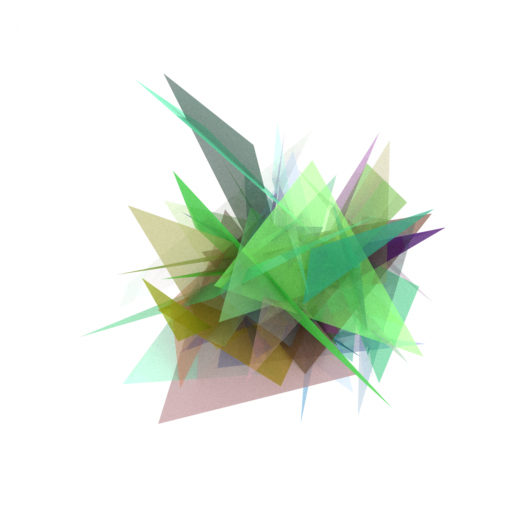

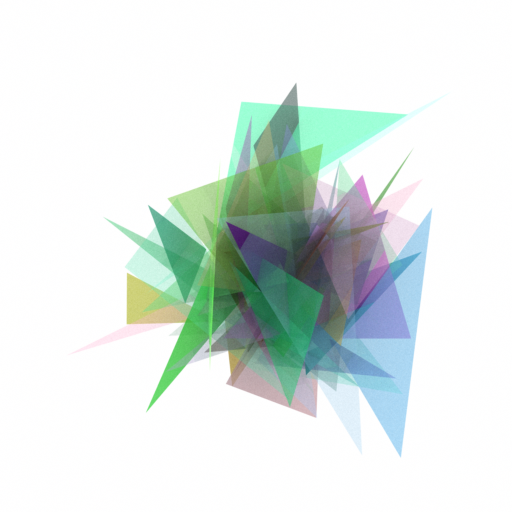

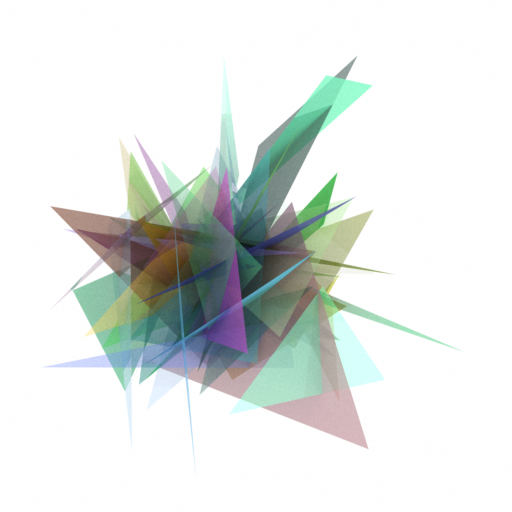

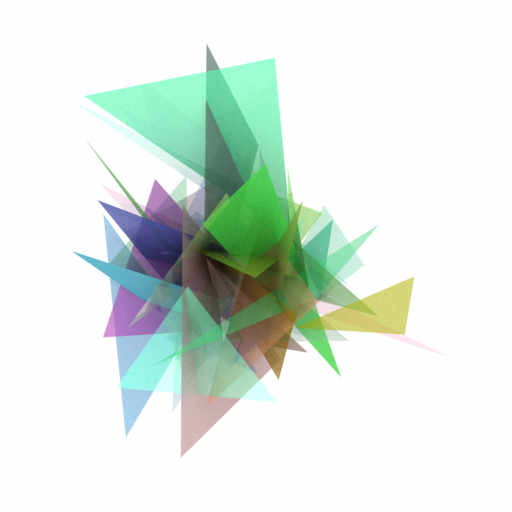

		 new overall best fitness. save to best_*`


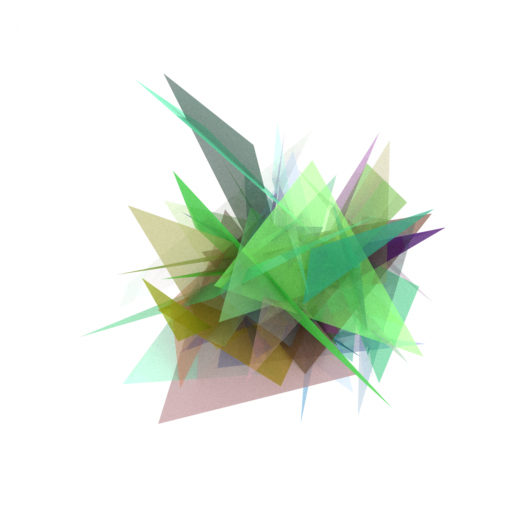

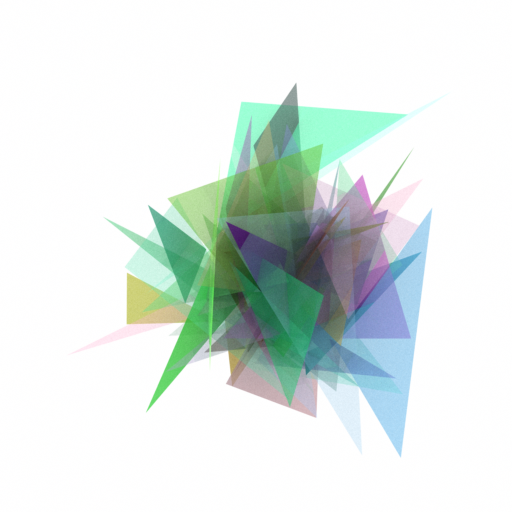

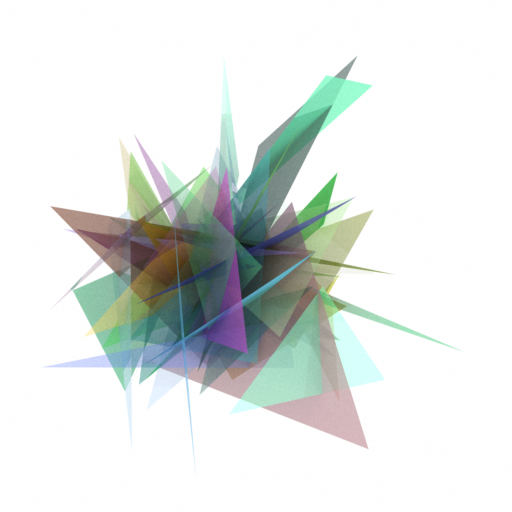

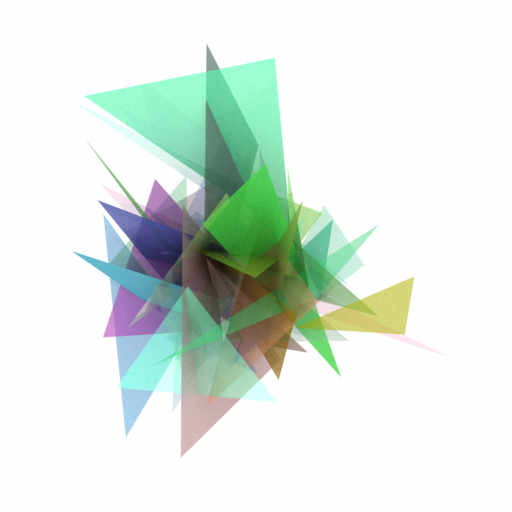

[0:10:37.588088] Iteration       50  ---  best_fitnesses [0.18985188]


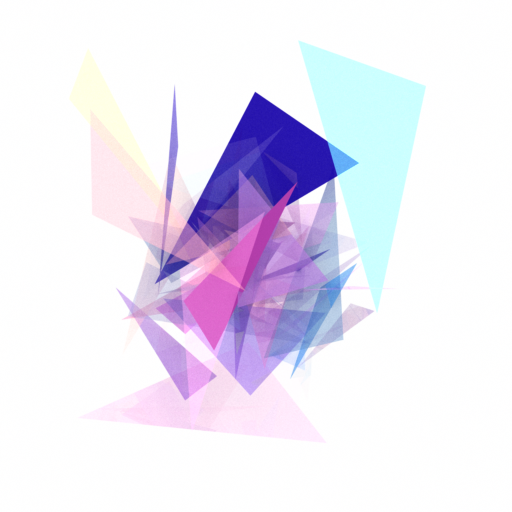

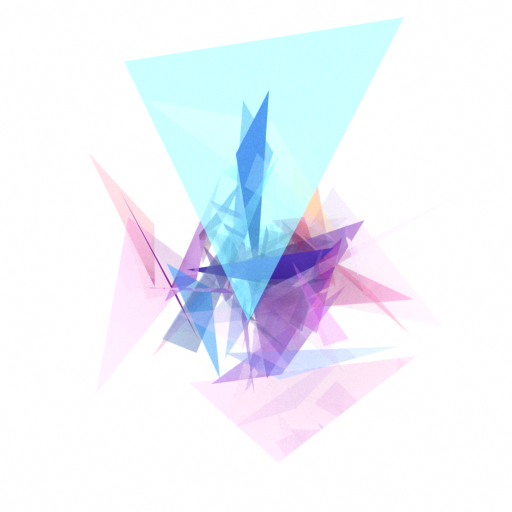

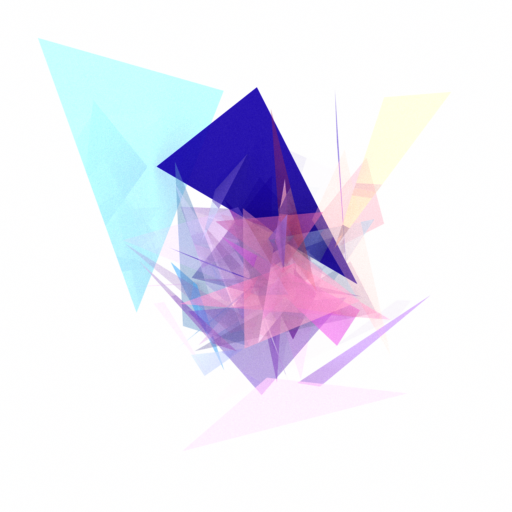

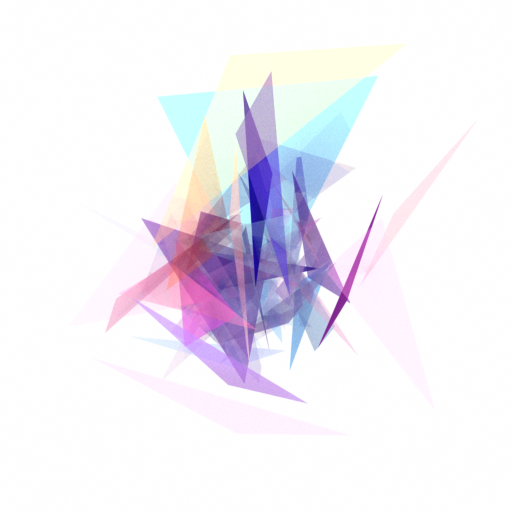

		 new overall best fitness. save to best_*`


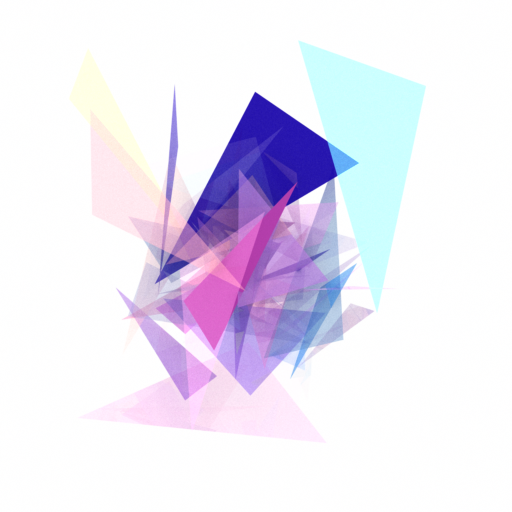

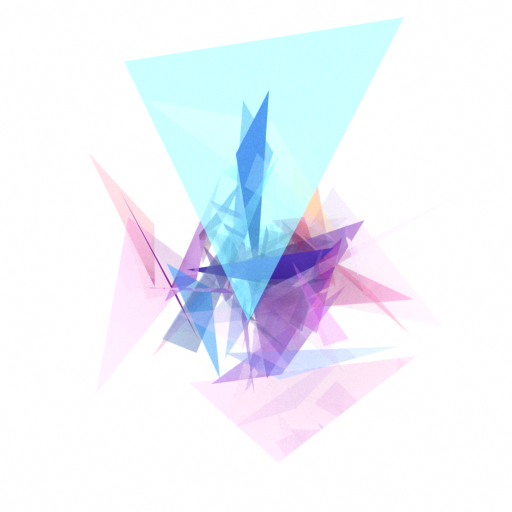

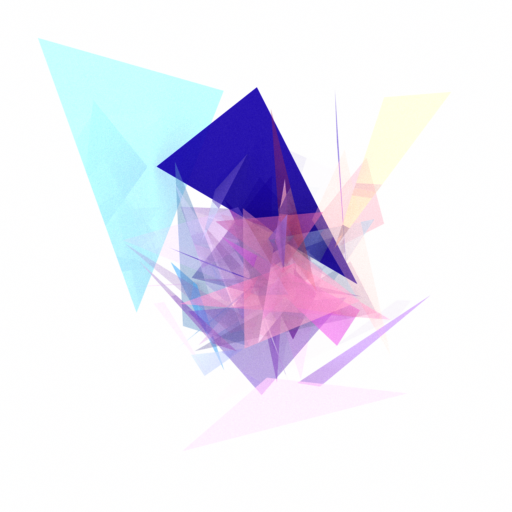

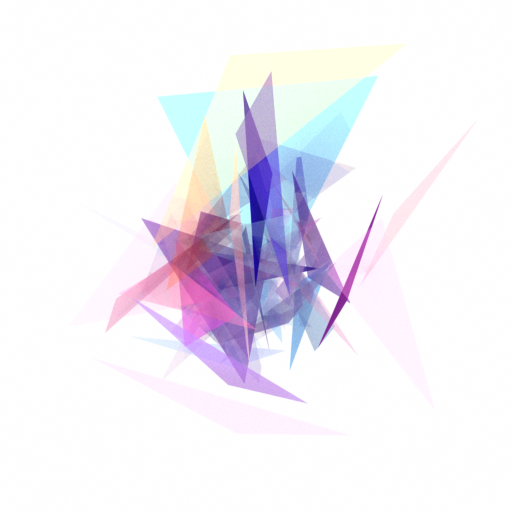

[0:20:20.557880] Iteration      100  ---  best_fitnesses [0.23684868]


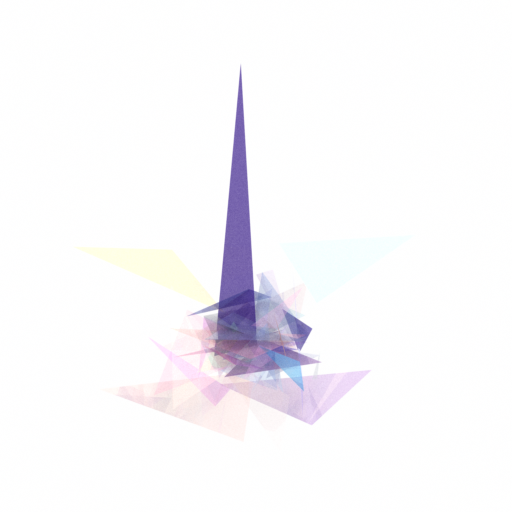

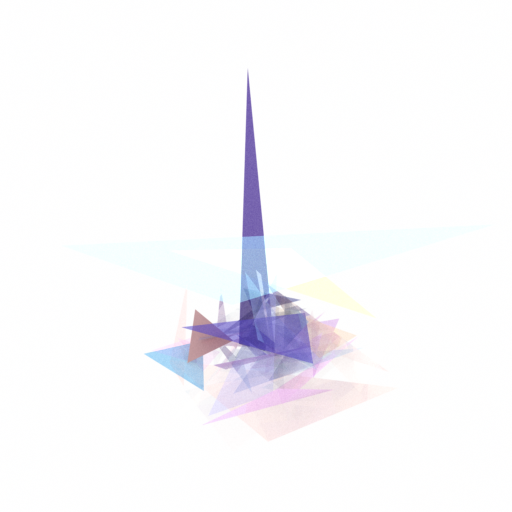

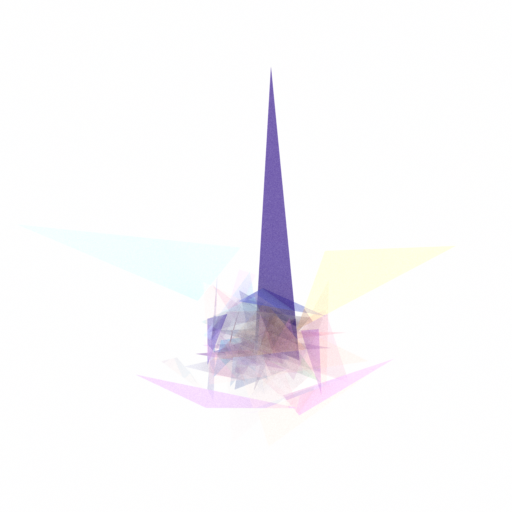

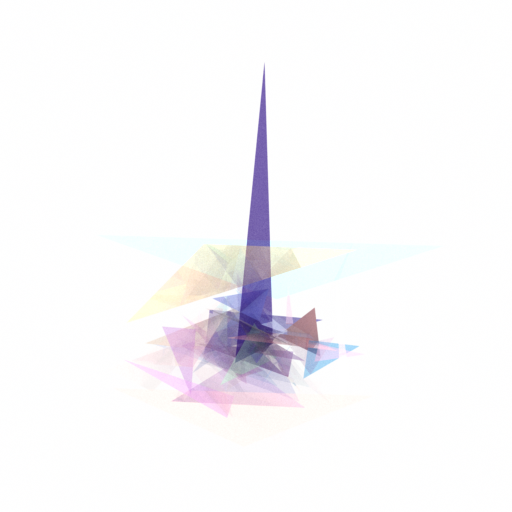

		 new overall best fitness. save to best_*`


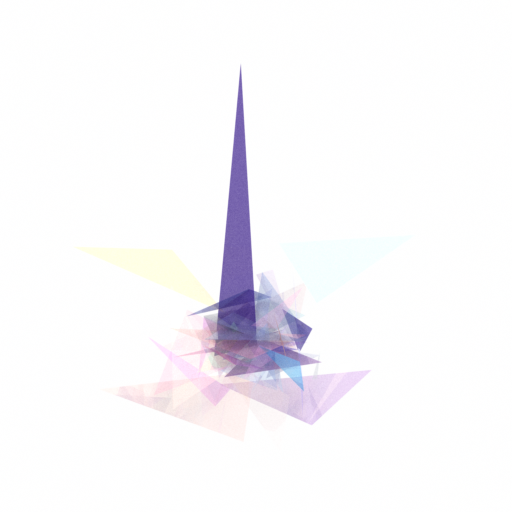

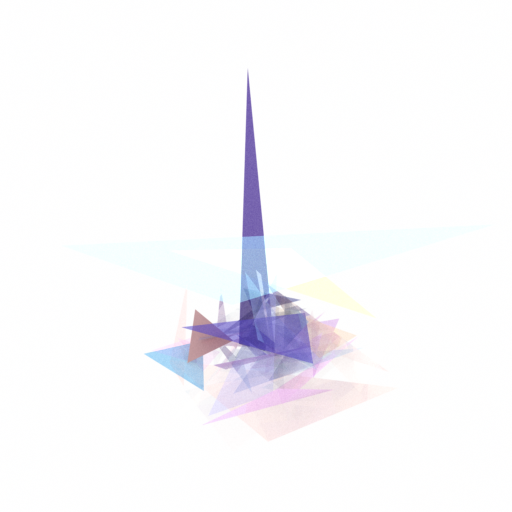

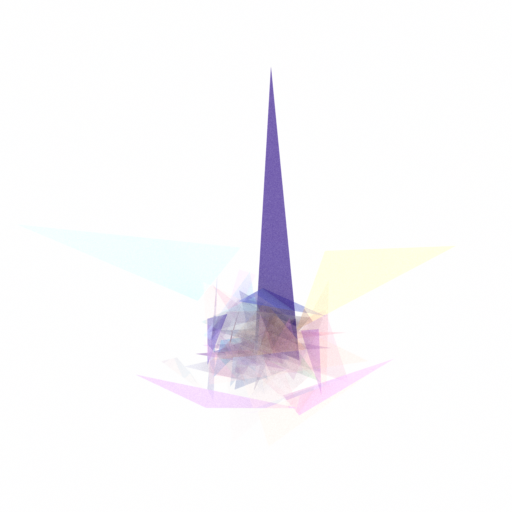

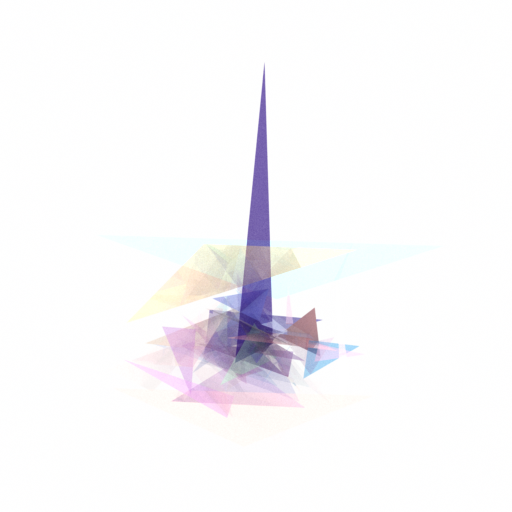

[0:29:21.136269] Iteration      150  ---  best_fitnesses [0.23364955]


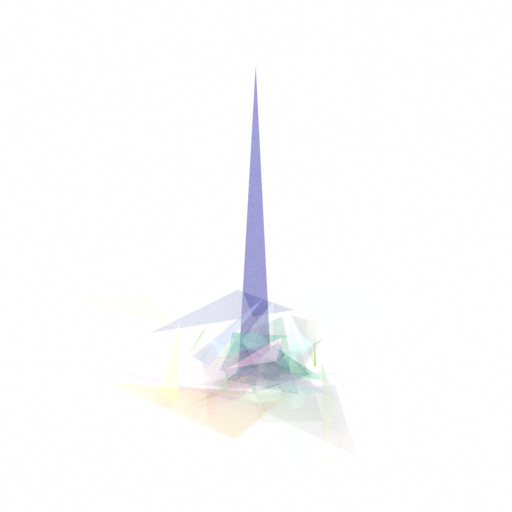

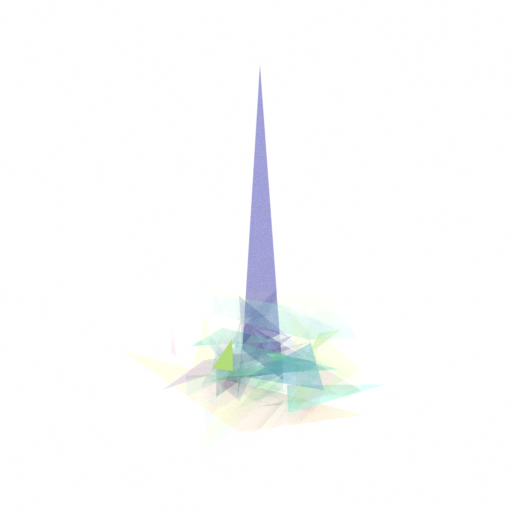

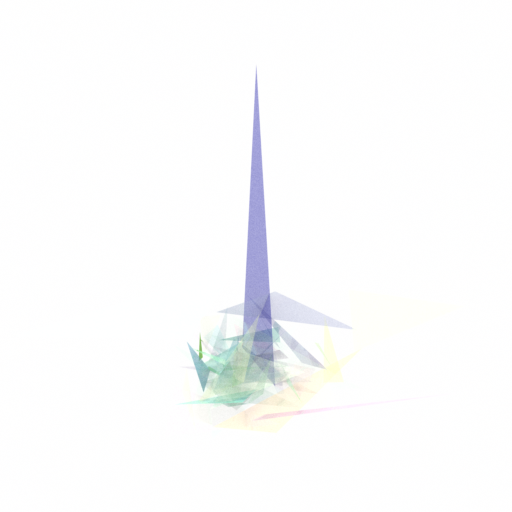

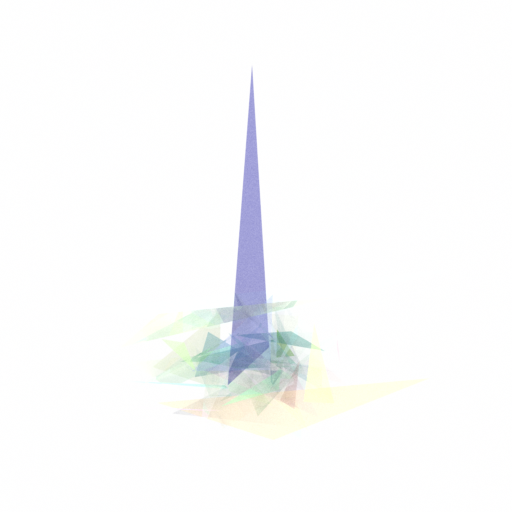

[0:38:23.299777] Iteration      200  ---  best_fitnesses [0.23439385]


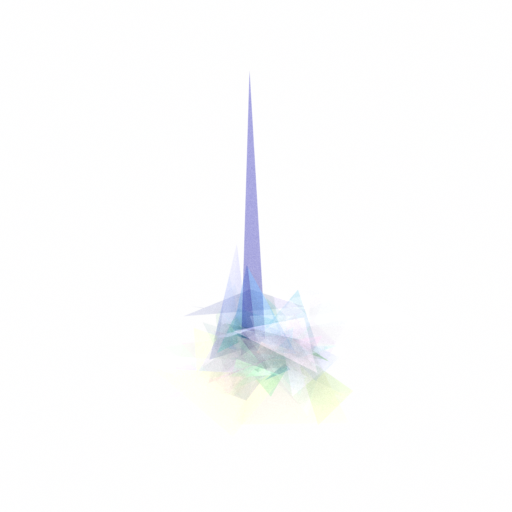

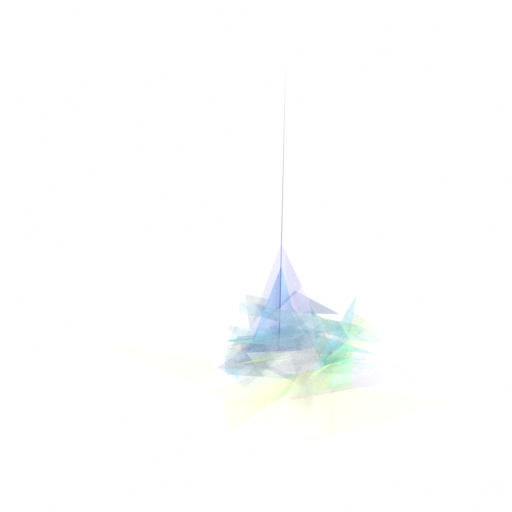

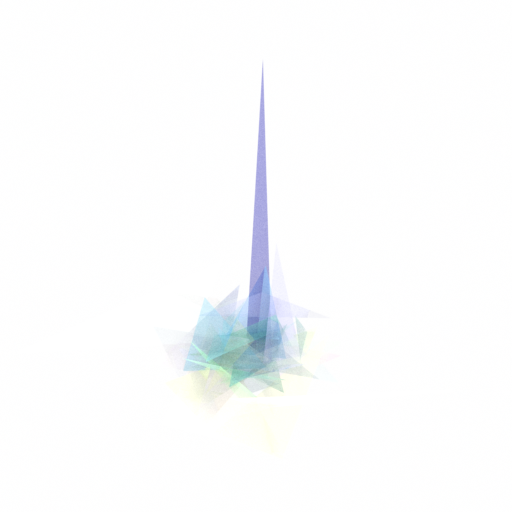

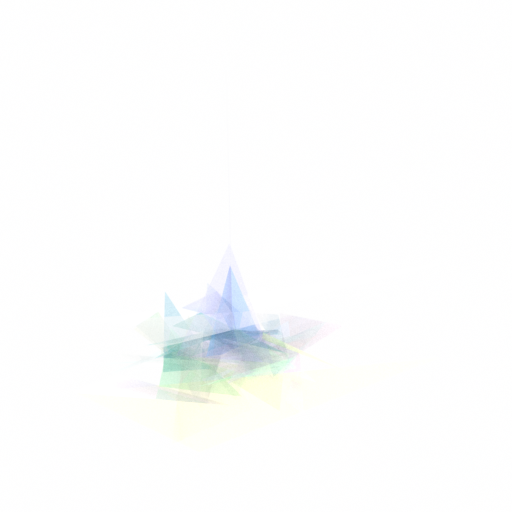

[0:47:17.776020] Iteration      250  ---  best_fitnesses [0.2665391]


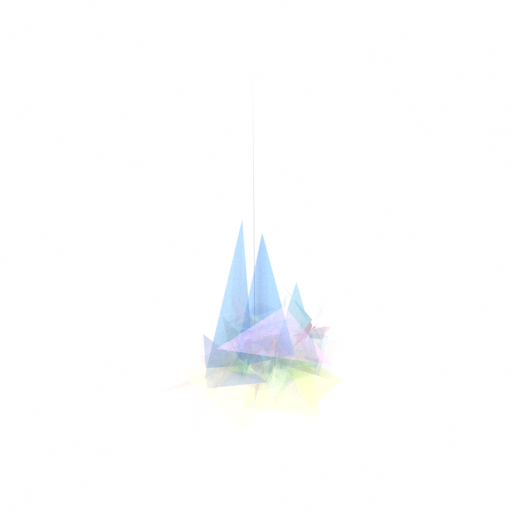

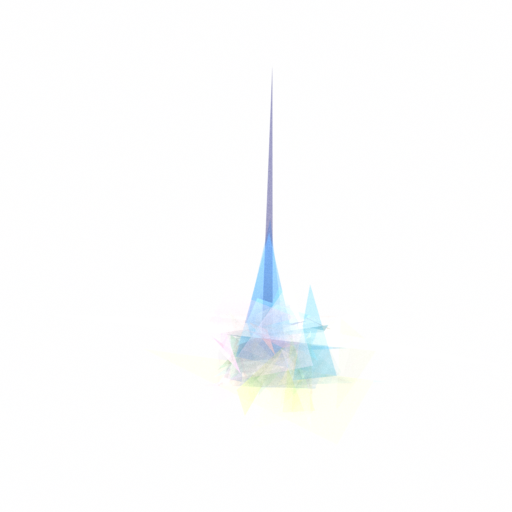

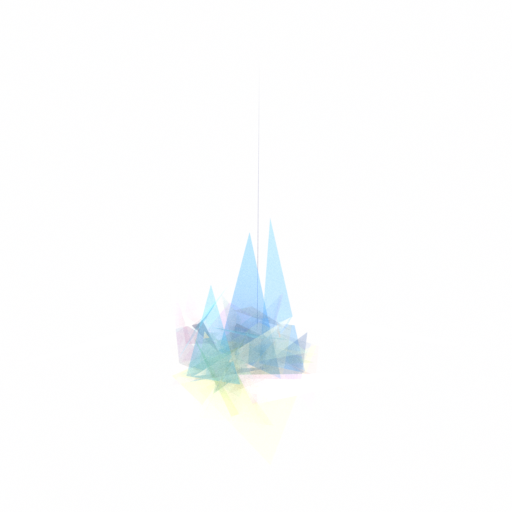

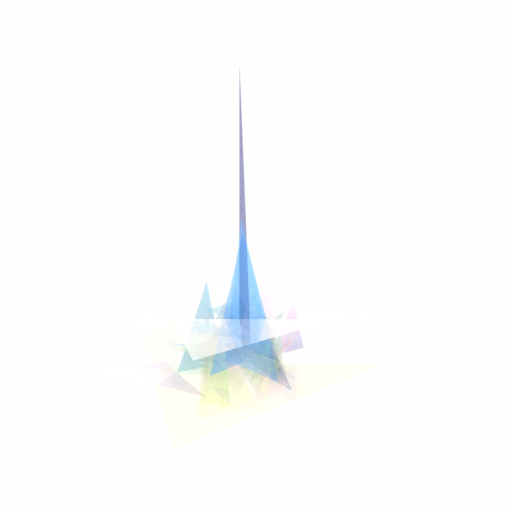

		 new overall best fitness. save to best_*`


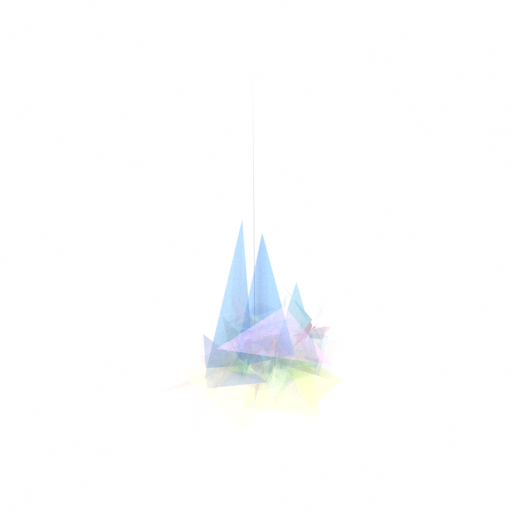

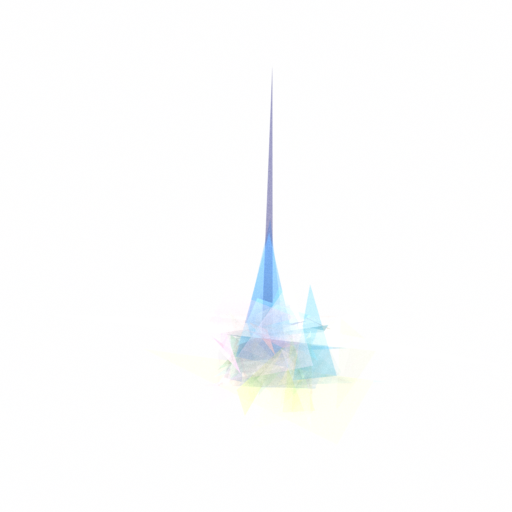

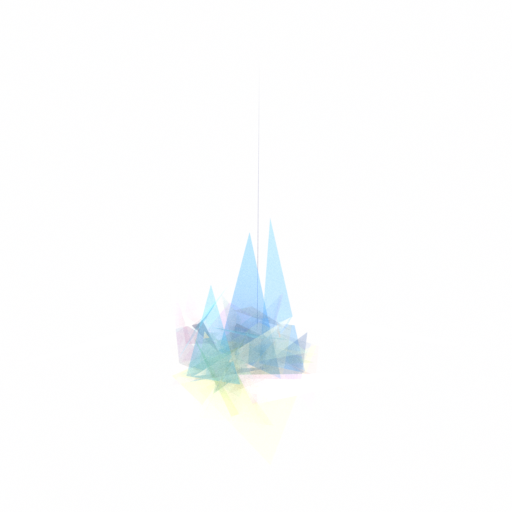

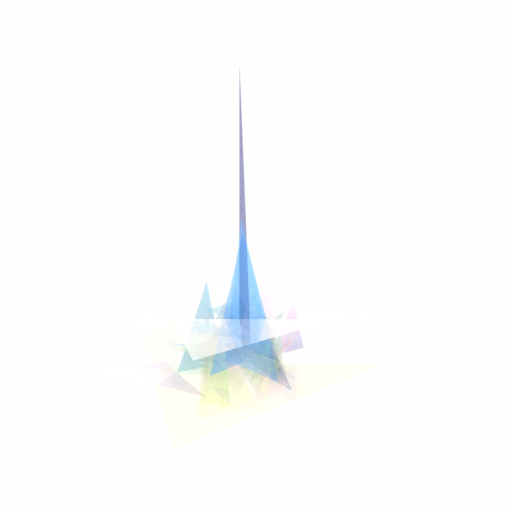

[0:56:12.034962] Iteration      300  ---  best_fitnesses [0.28970543]


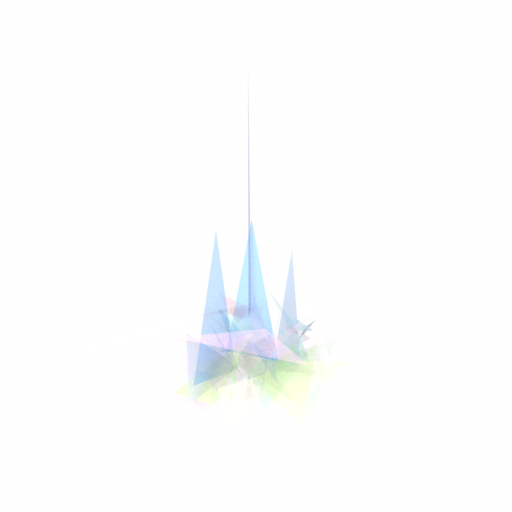

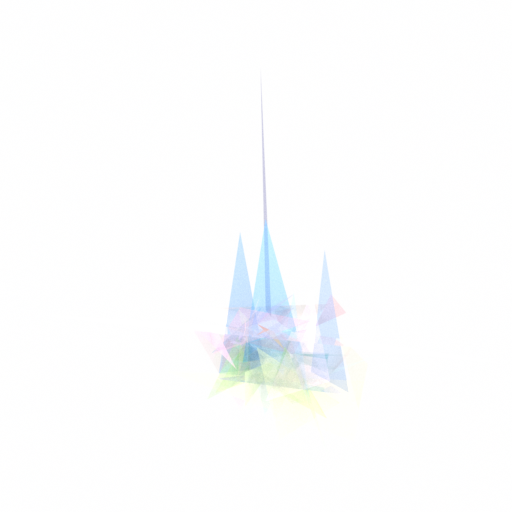

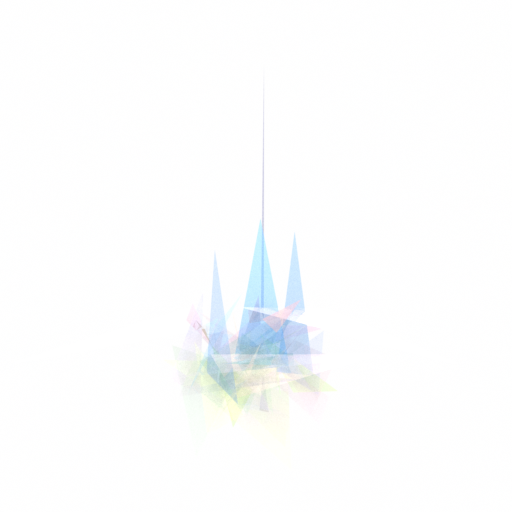

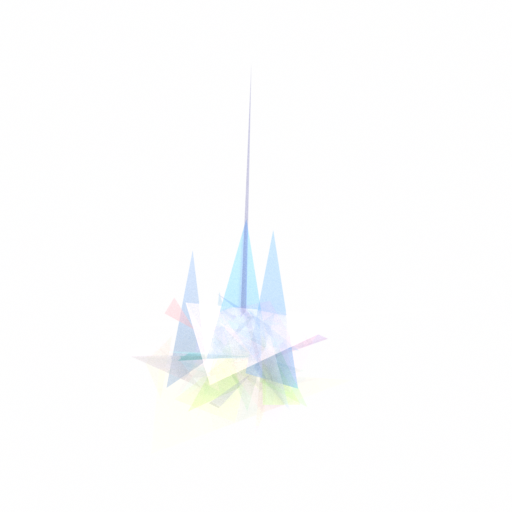

		 new overall best fitness. save to best_*`


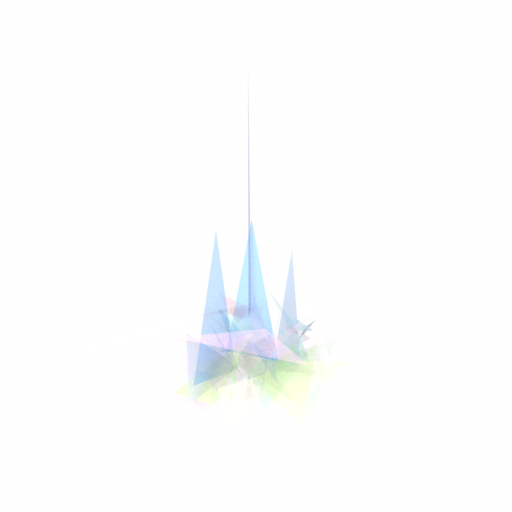

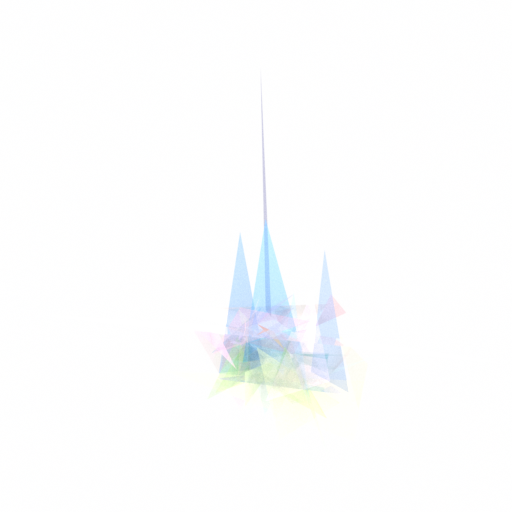

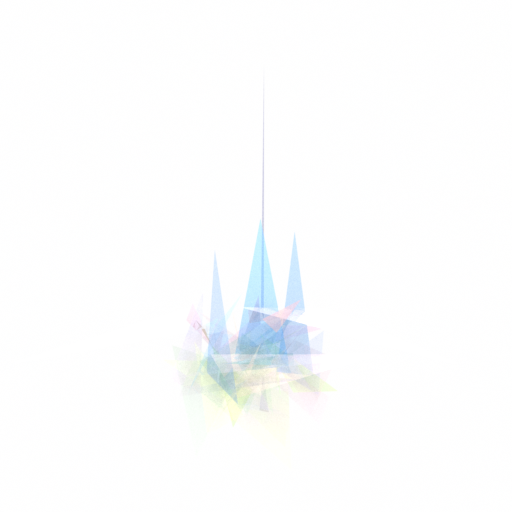

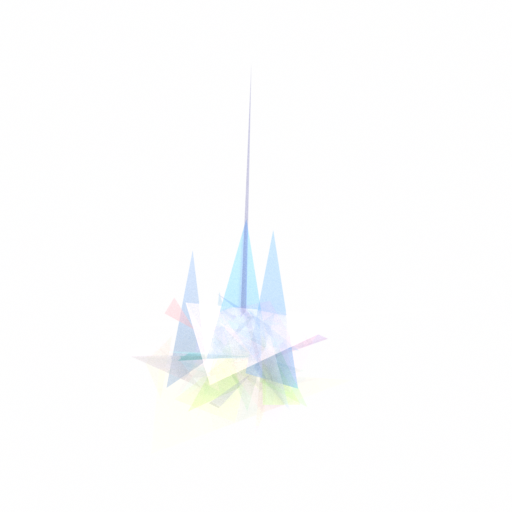

[1:05:02.293339] Iteration      350  ---  best_fitnesses [0.29435638]


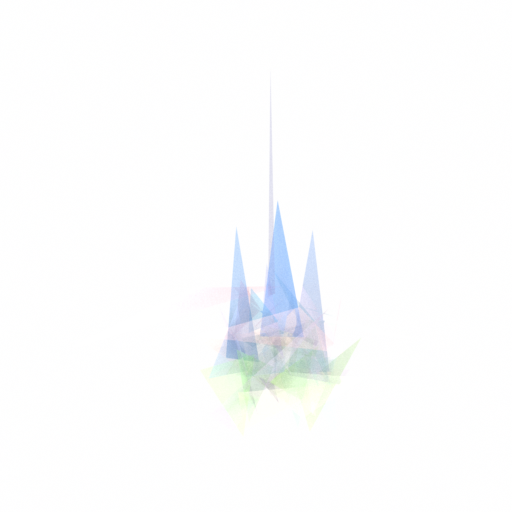

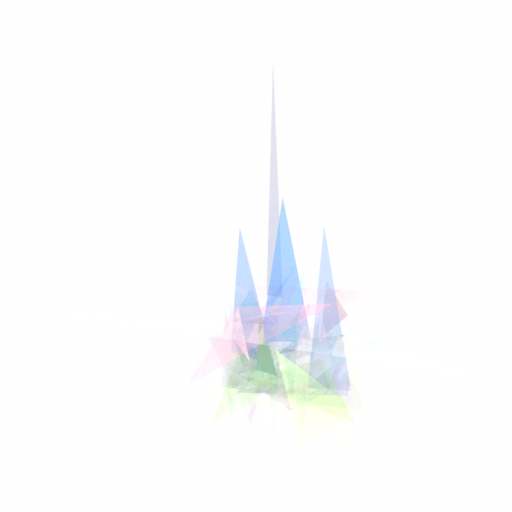

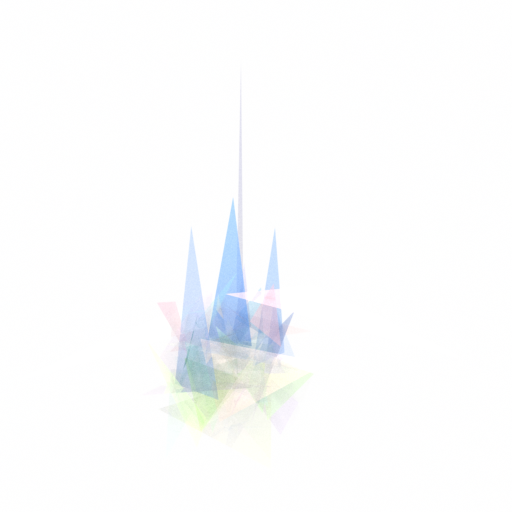

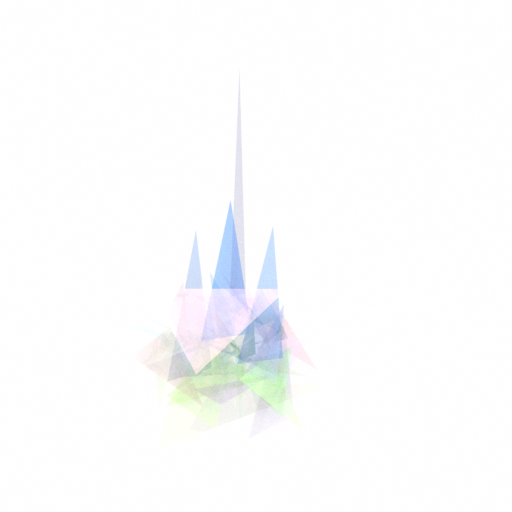

		 new overall best fitness. save to best_*`


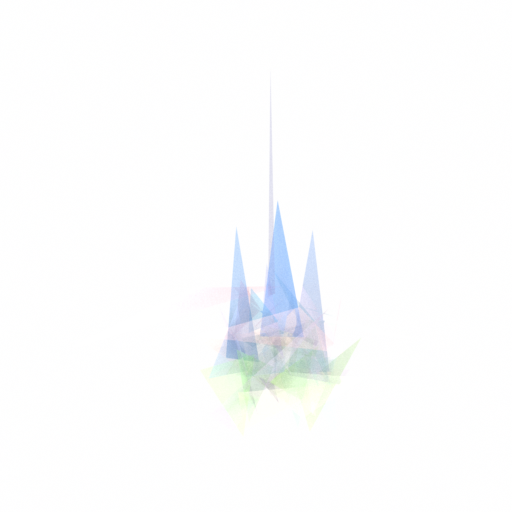

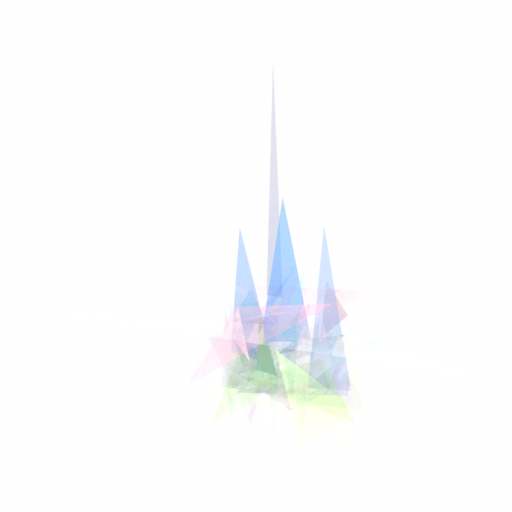

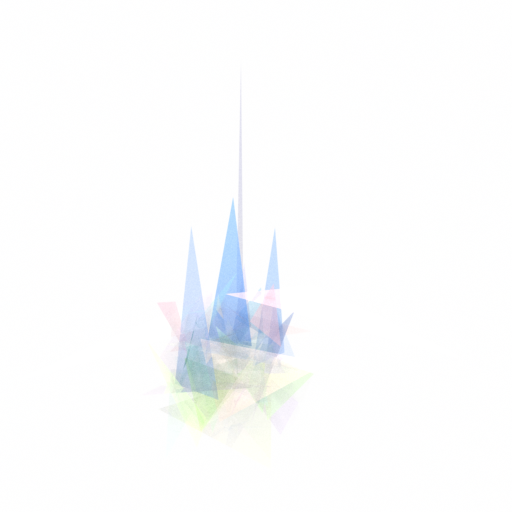

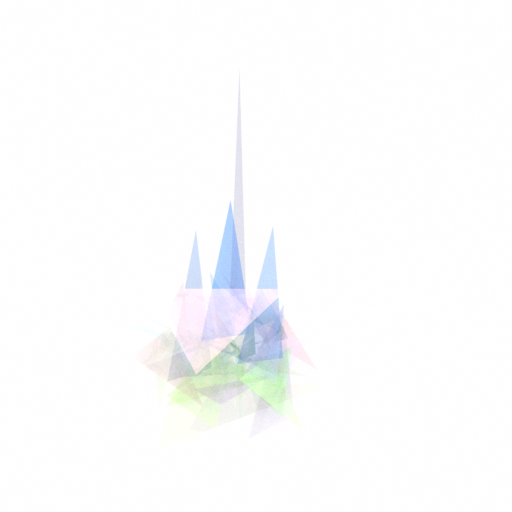

[1:13:54.903284] Iteration      400  ---  best_fitnesses [0.29819536]


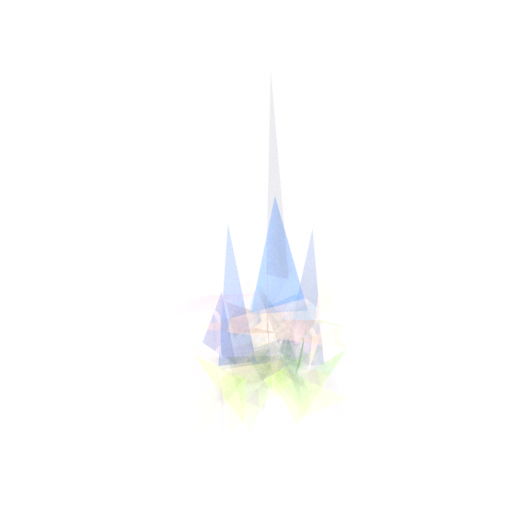

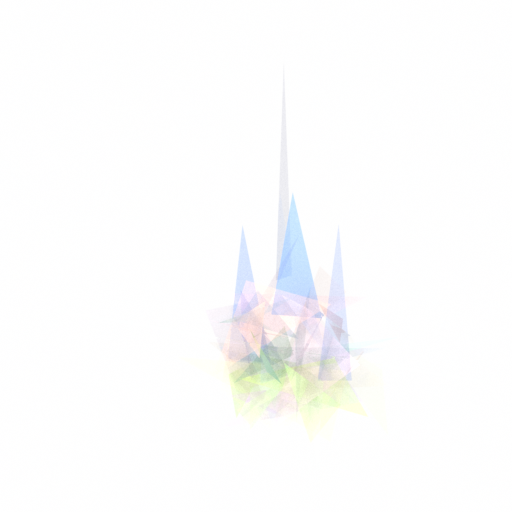

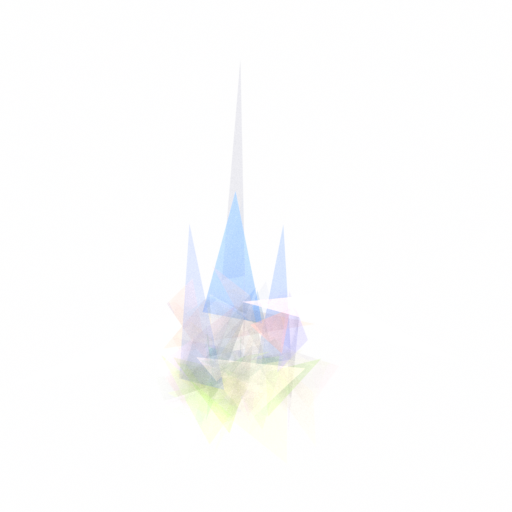

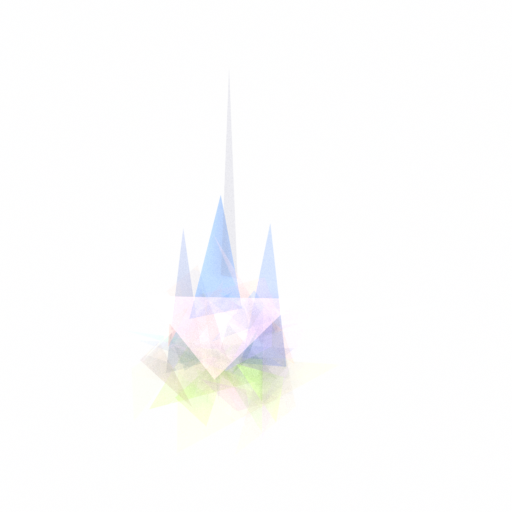

		 new overall best fitness. save to best_*`


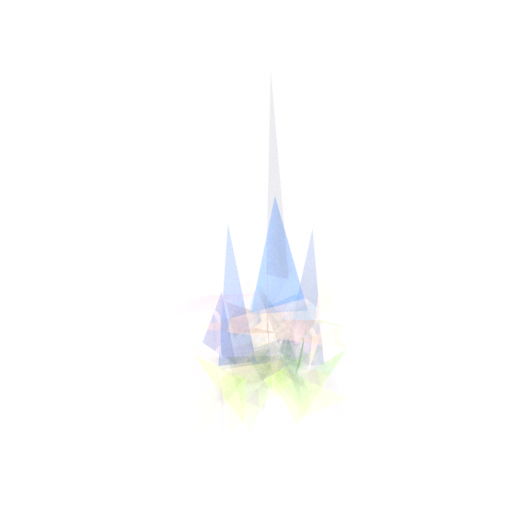

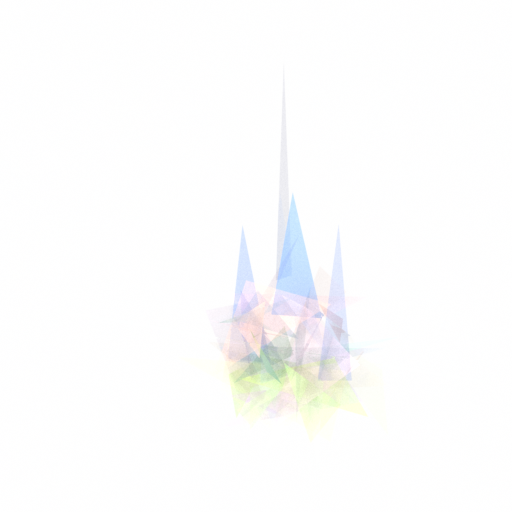

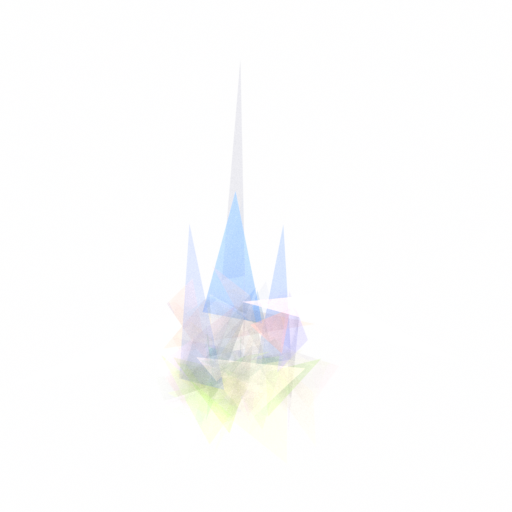

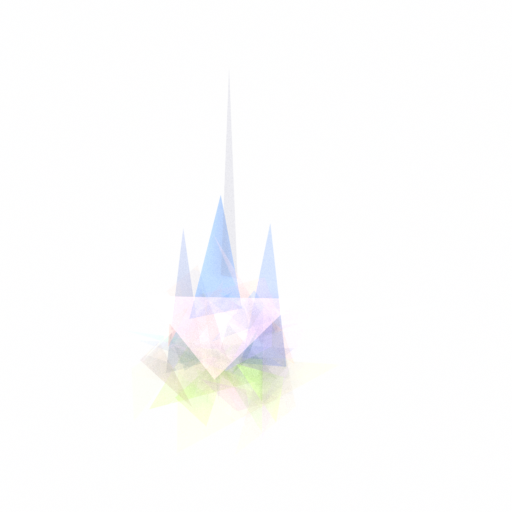

[1:22:46.226167] Iteration      450  ---  best_fitnesses [0.30498397]


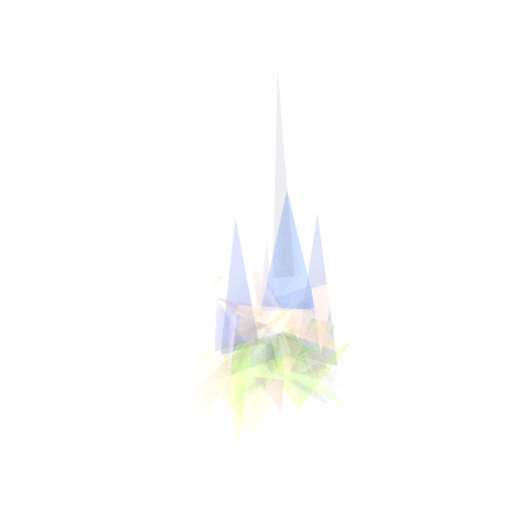

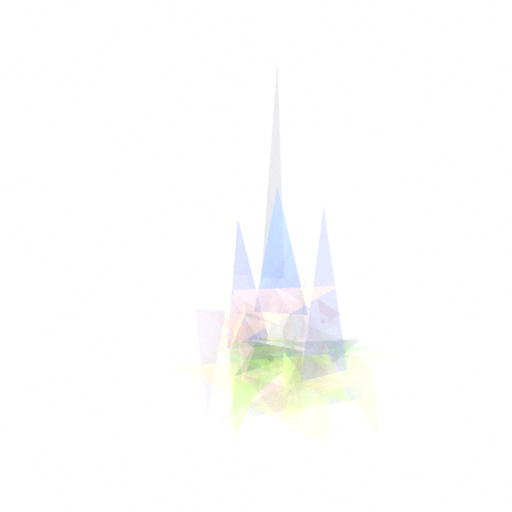

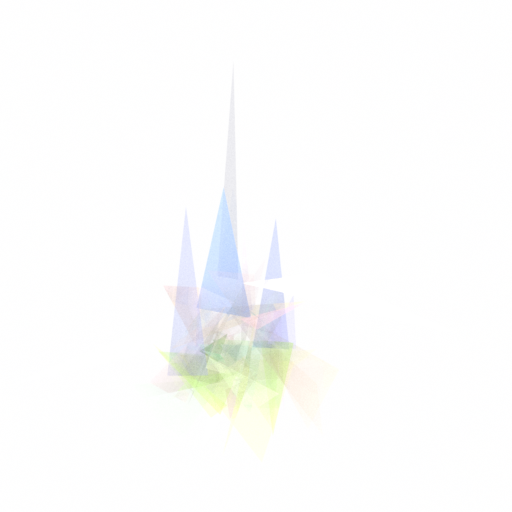

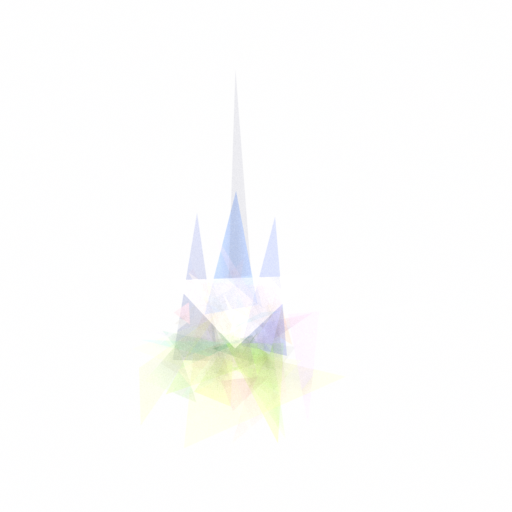

		 new overall best fitness. save to best_*`


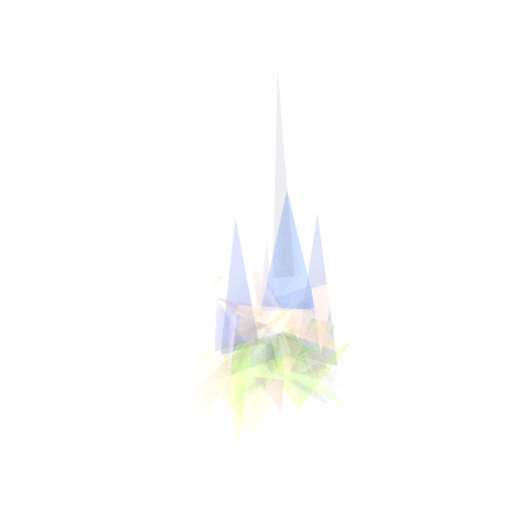

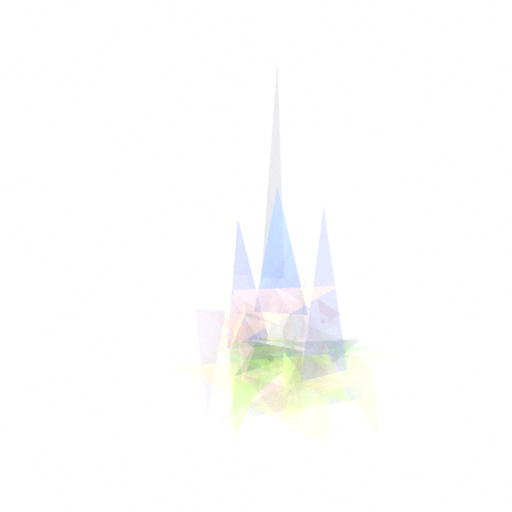

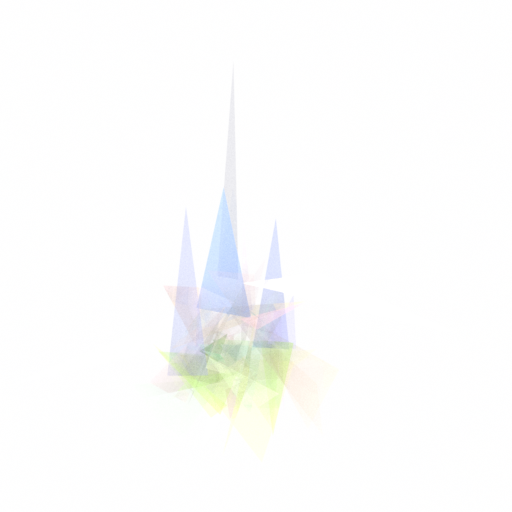

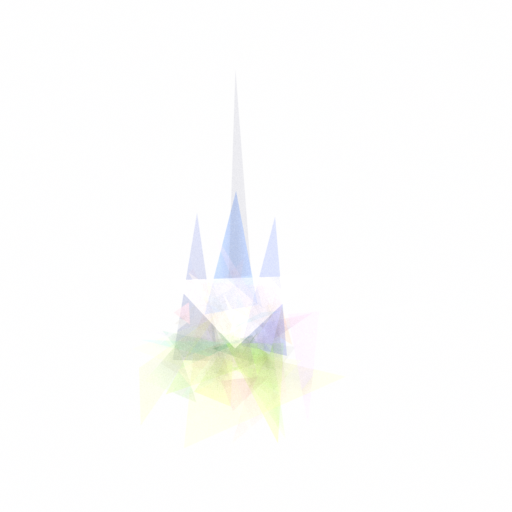

[1:31:54.489494] Iteration      500  ---  best_fitnesses [0.30876344]


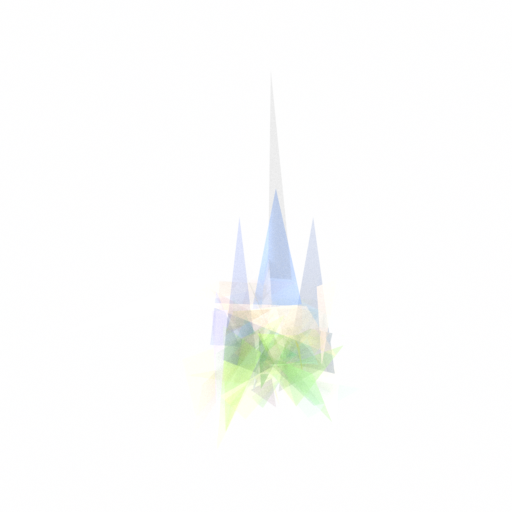

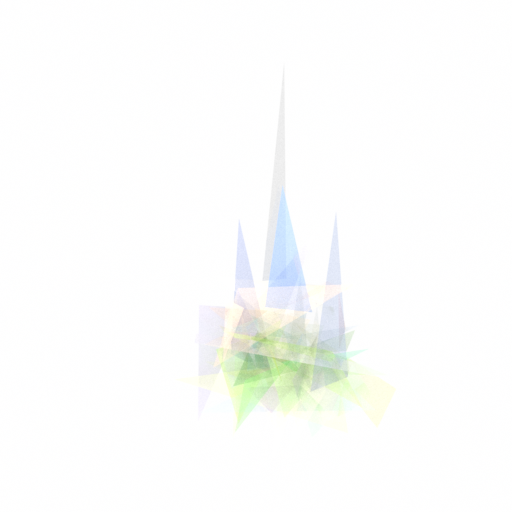

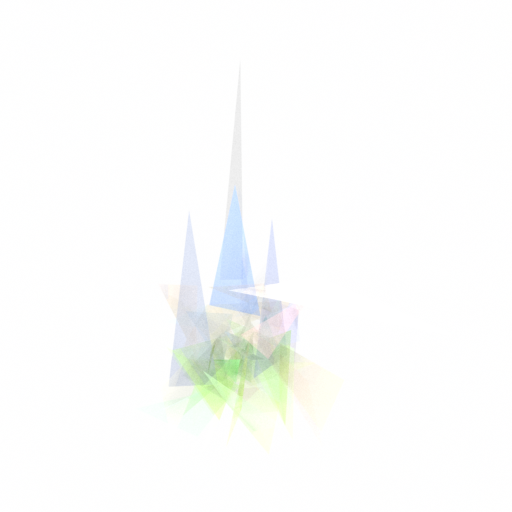

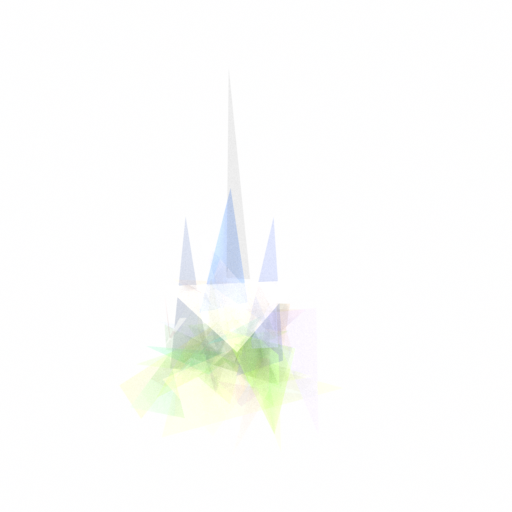

		 new overall best fitness. save to best_*`


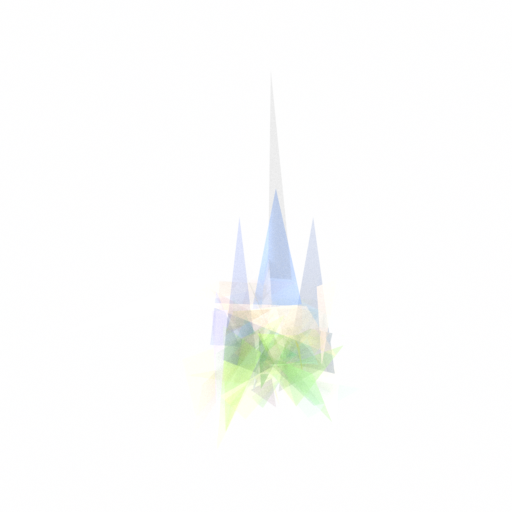

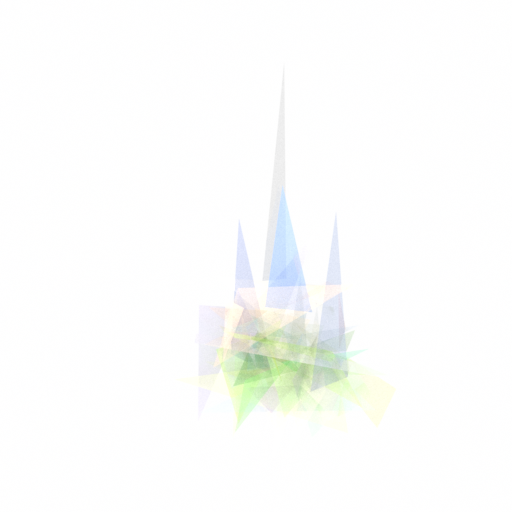

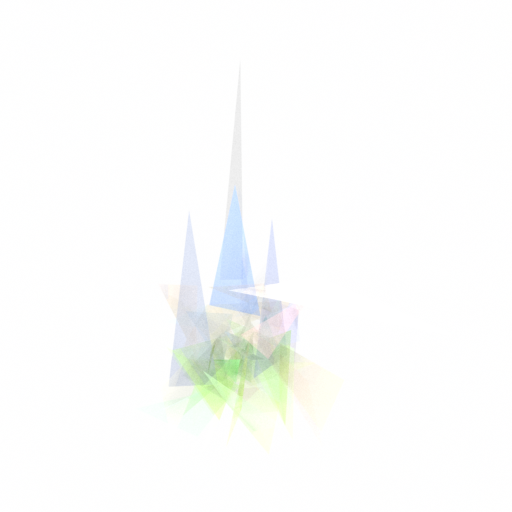

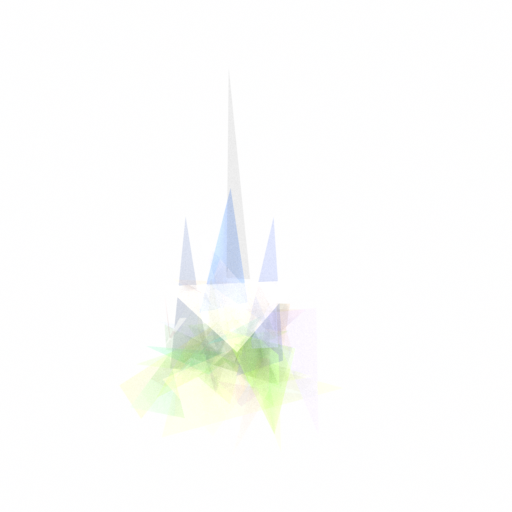

[1:41:12.952680] Iteration      550  ---  best_fitnesses [0.3095845]


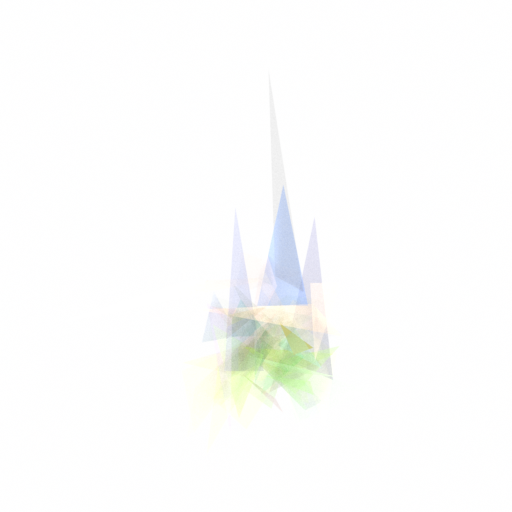

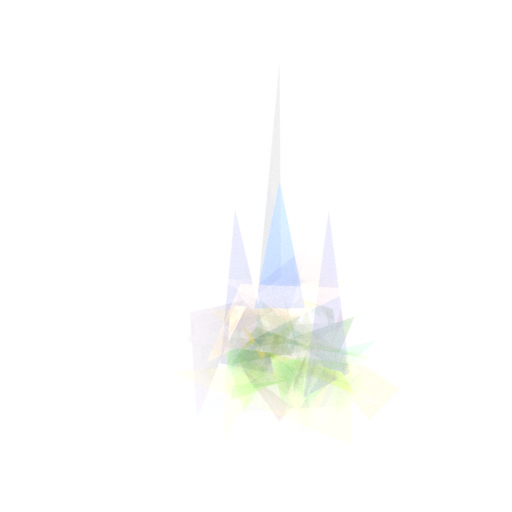

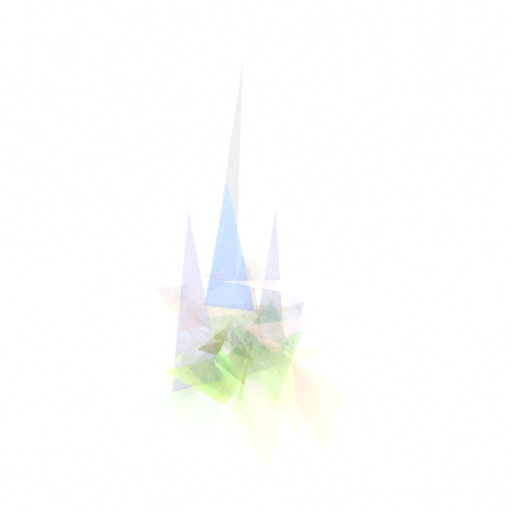

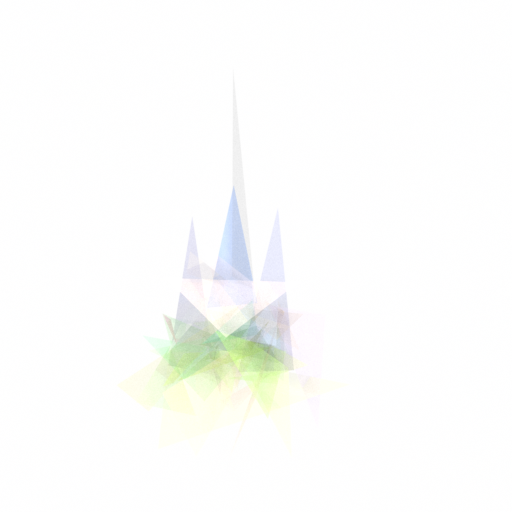

		 new overall best fitness. save to best_*`


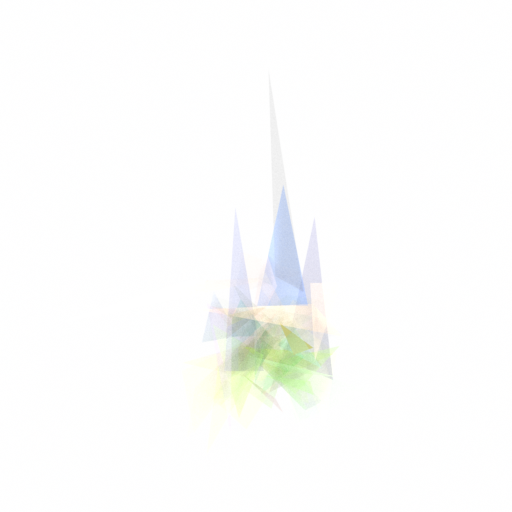

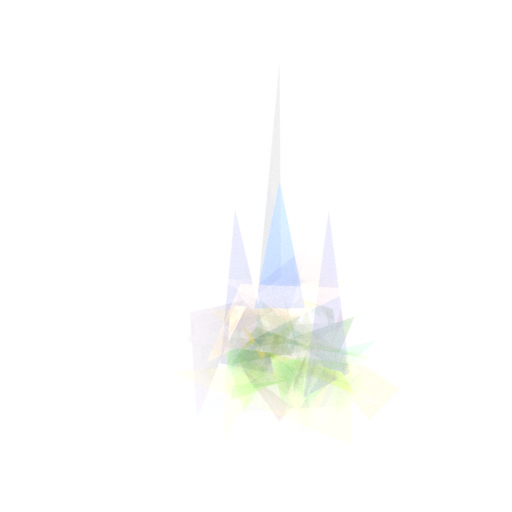

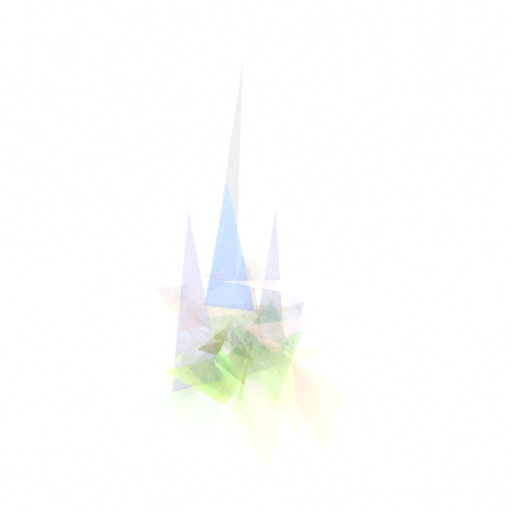

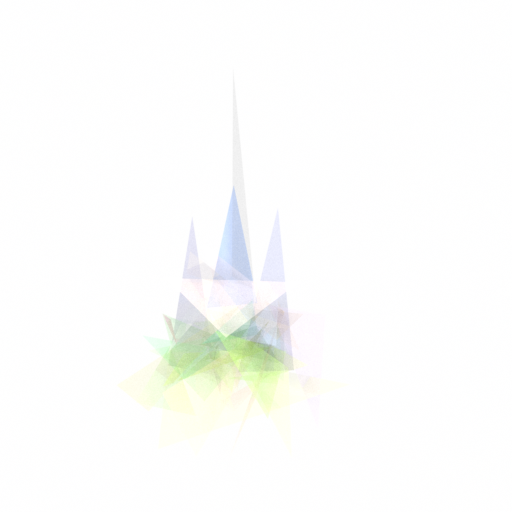

[1:50:06.174831] Iteration      600  ---  best_fitnesses [0.31422612]


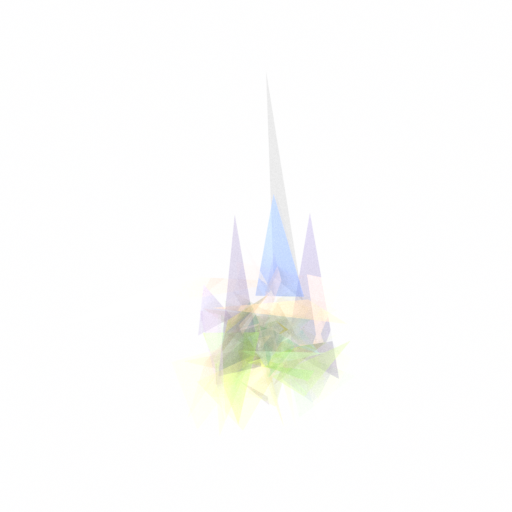

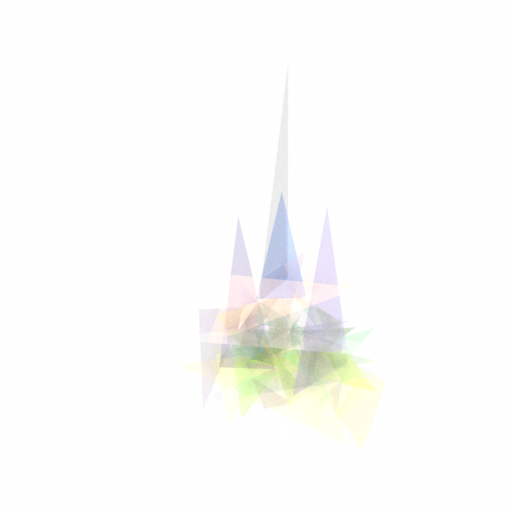

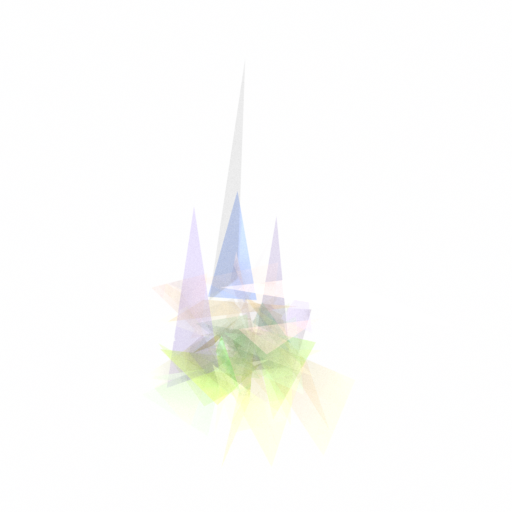

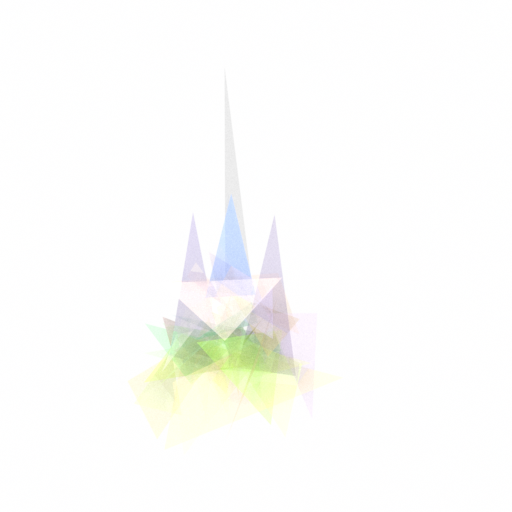

		 new overall best fitness. save to best_*`


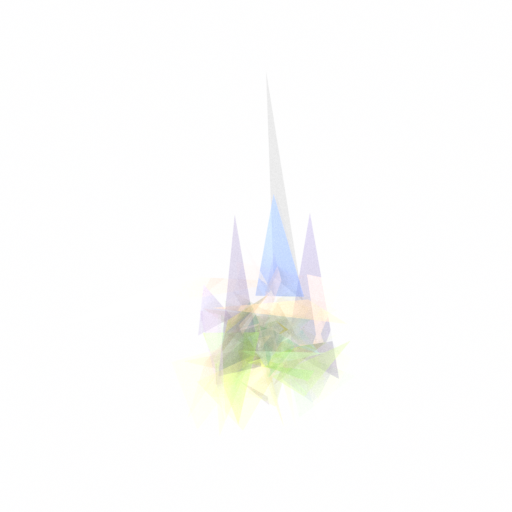

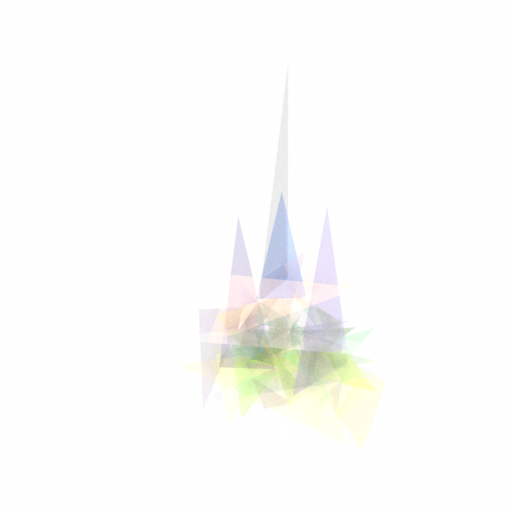

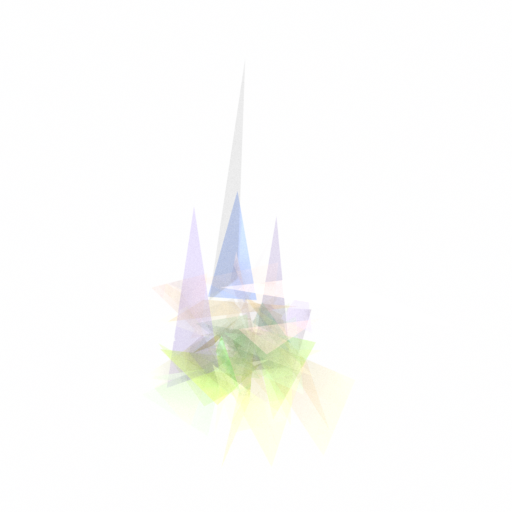

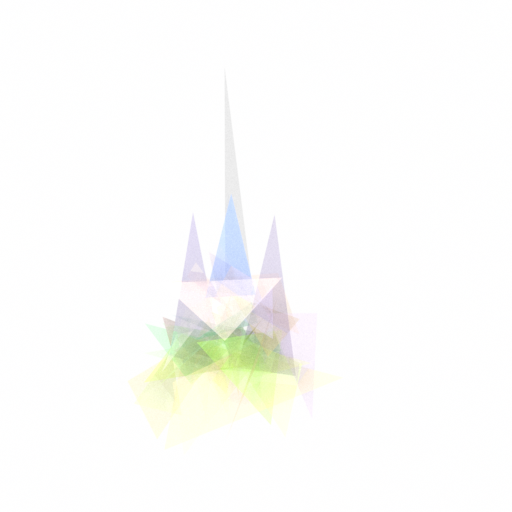

[1:58:59.666404] Iteration      650  ---  best_fitnesses [0.3140945]


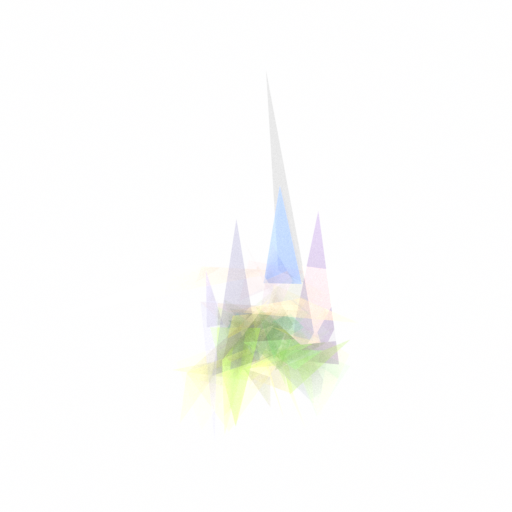

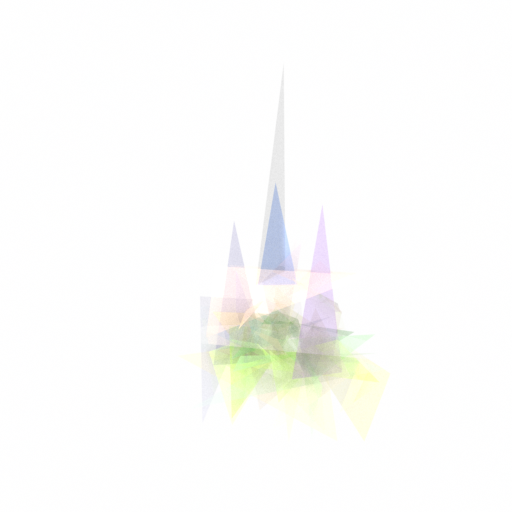

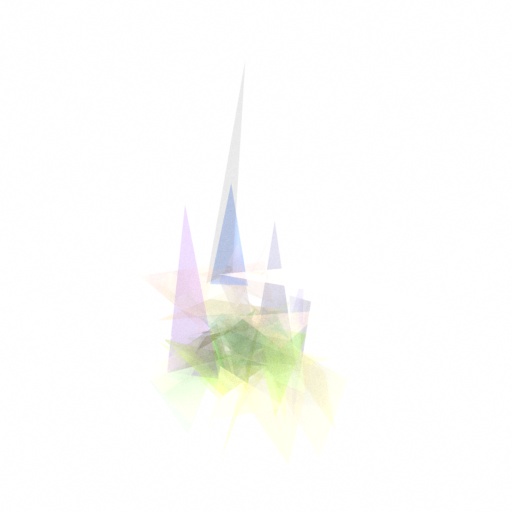

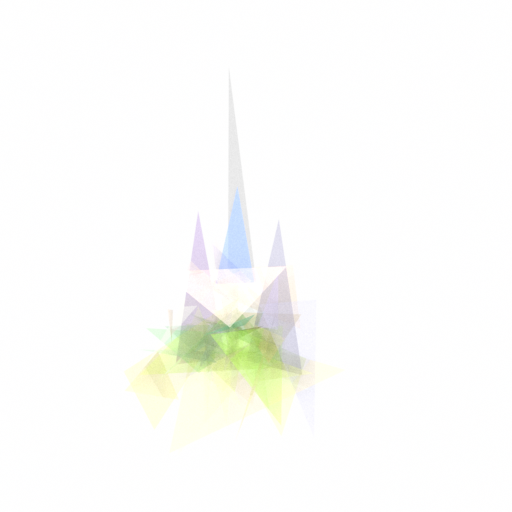

[2:07:50.954752] Iteration      700  ---  best_fitnesses [0.31889197]


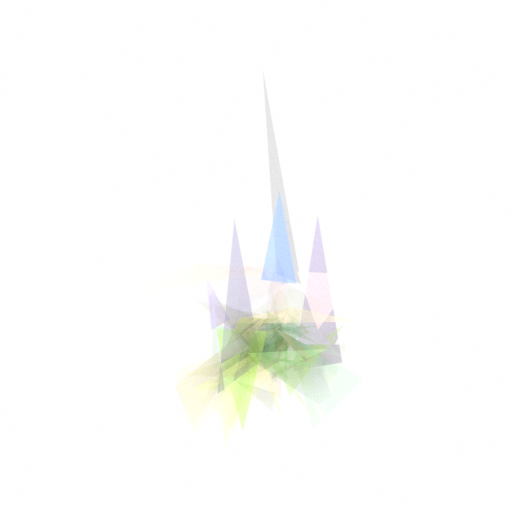

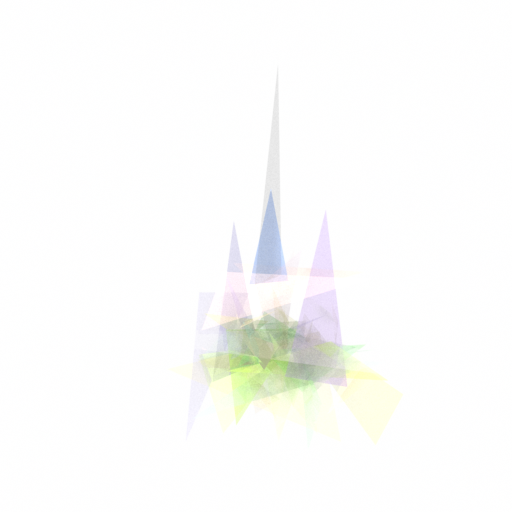

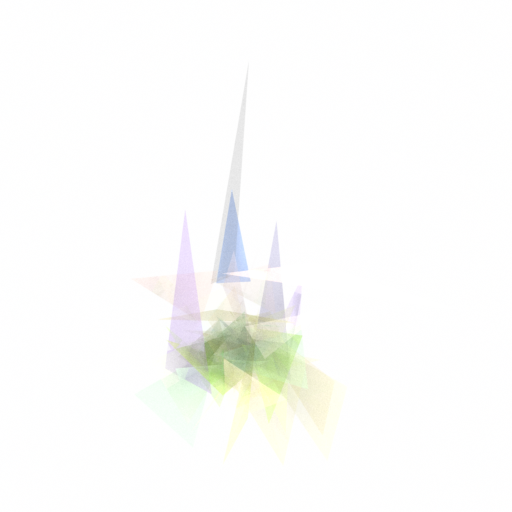

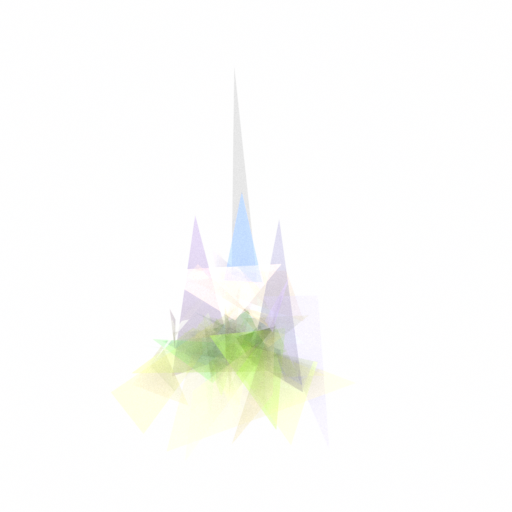

		 new overall best fitness. save to best_*`


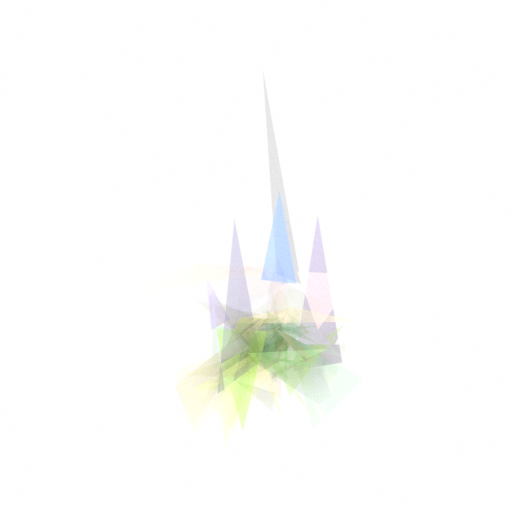

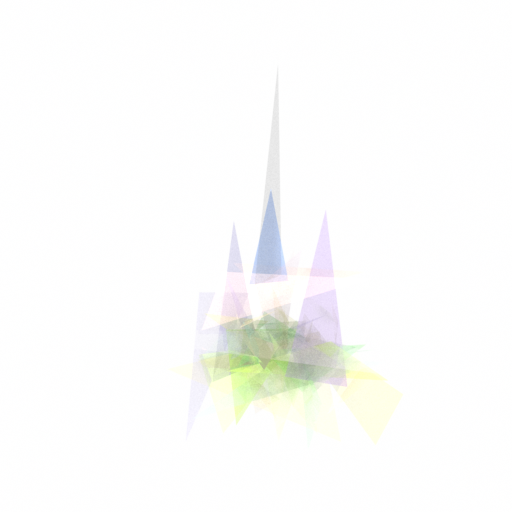

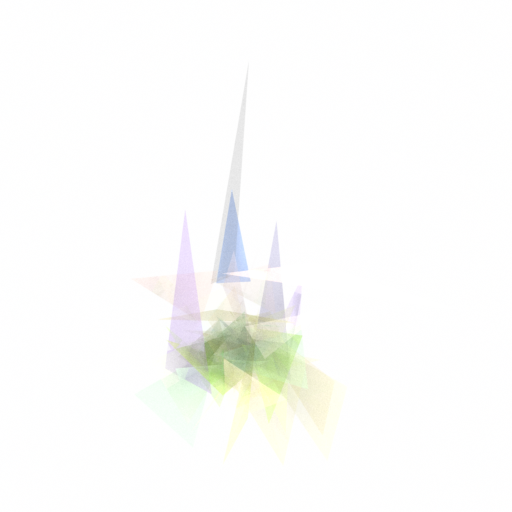

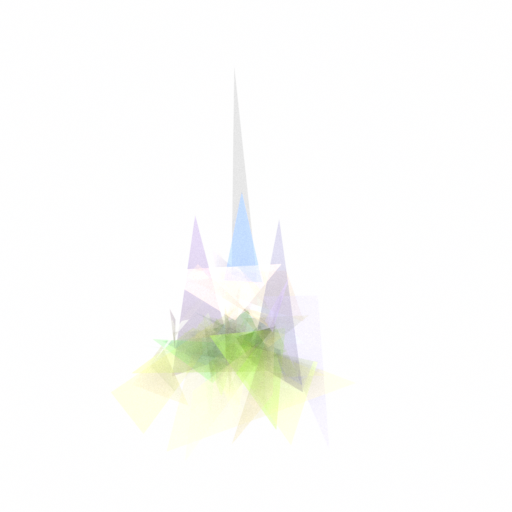

[2:16:42.764767] Iteration      750  ---  best_fitnesses [0.3224324]


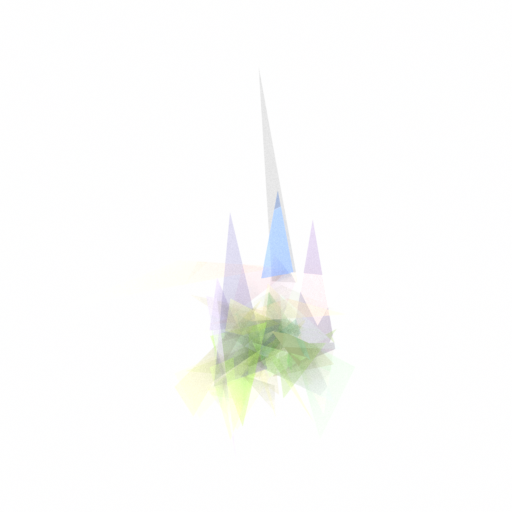

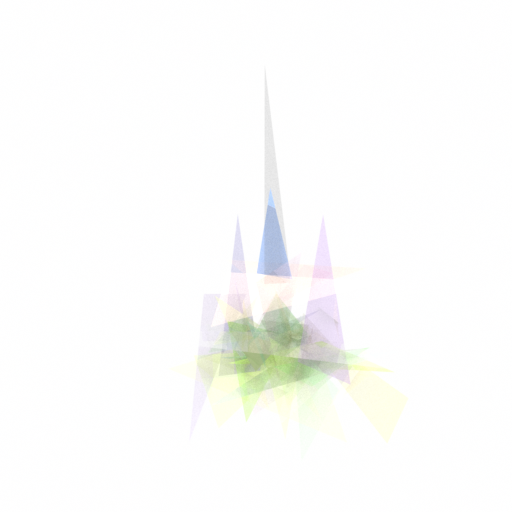

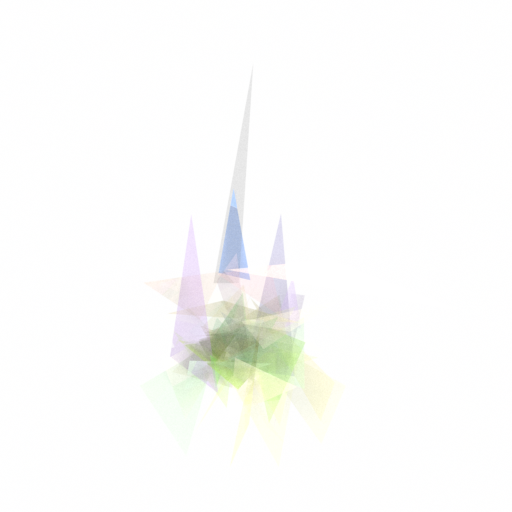

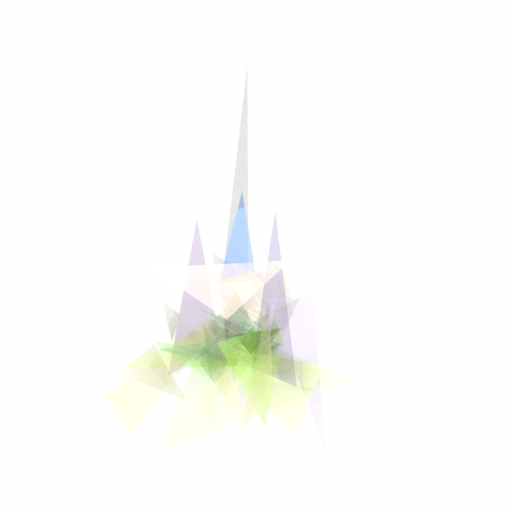

		 new overall best fitness. save to best_*`


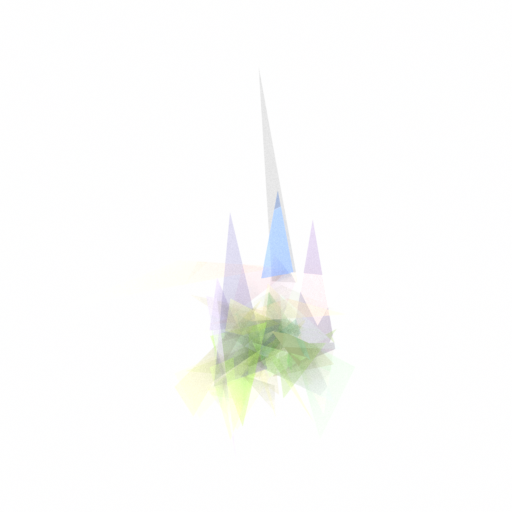

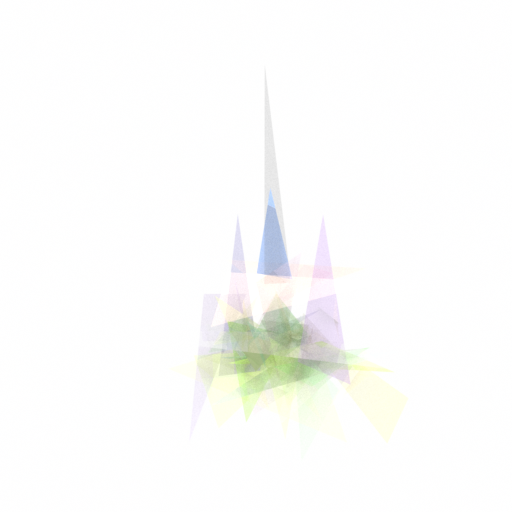

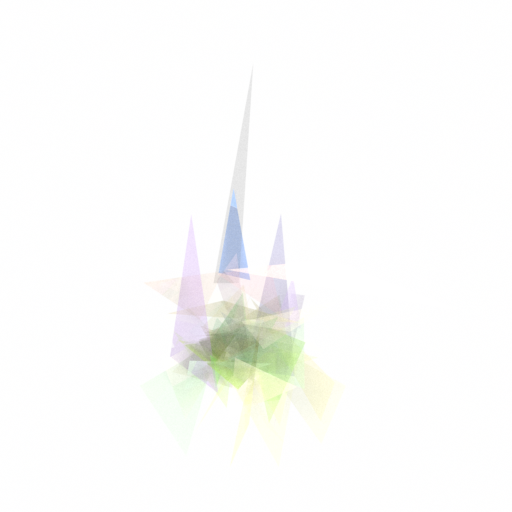

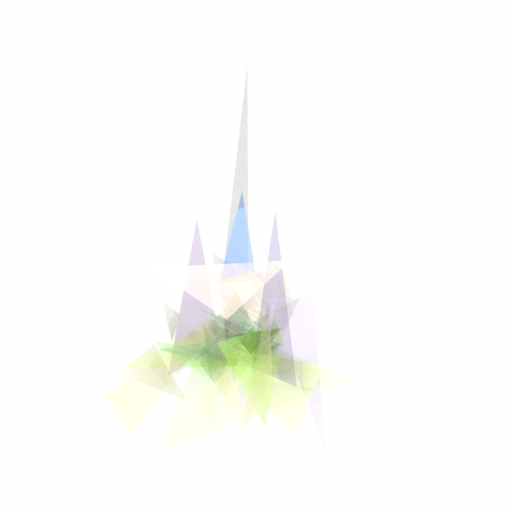

[2:25:35.418418] Iteration      800  ---  best_fitnesses [0.32508764]


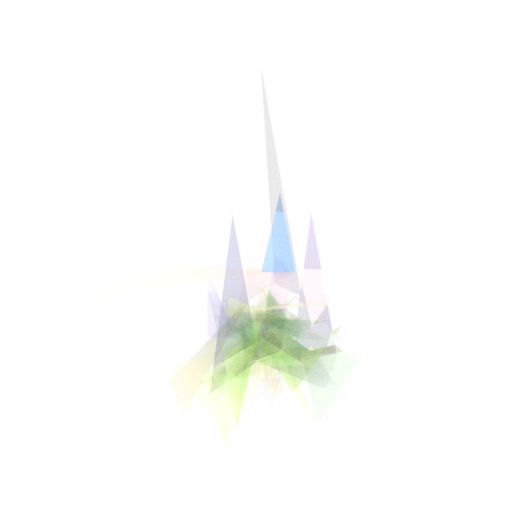

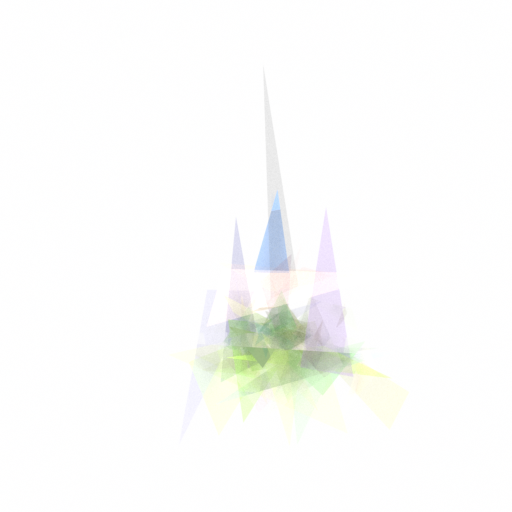

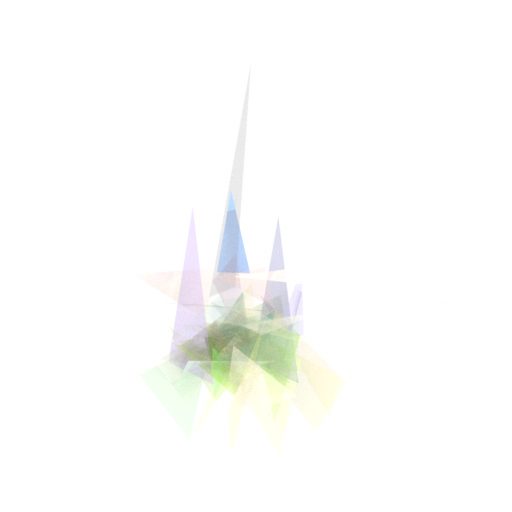

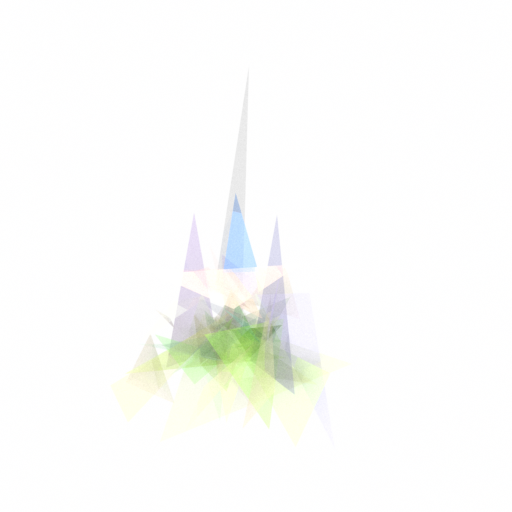

		 new overall best fitness. save to best_*`


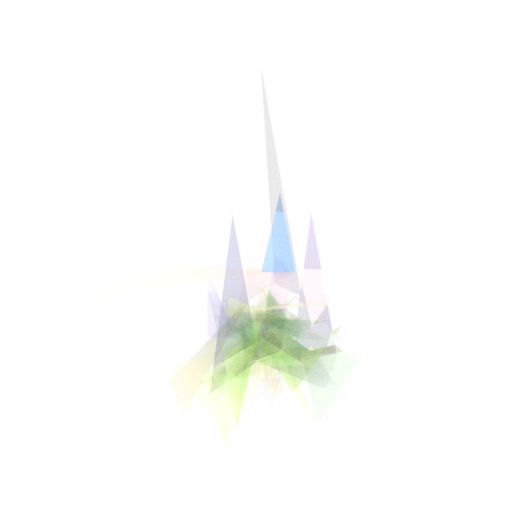

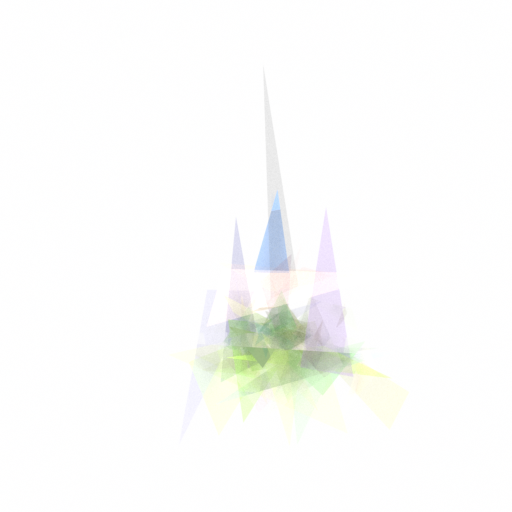

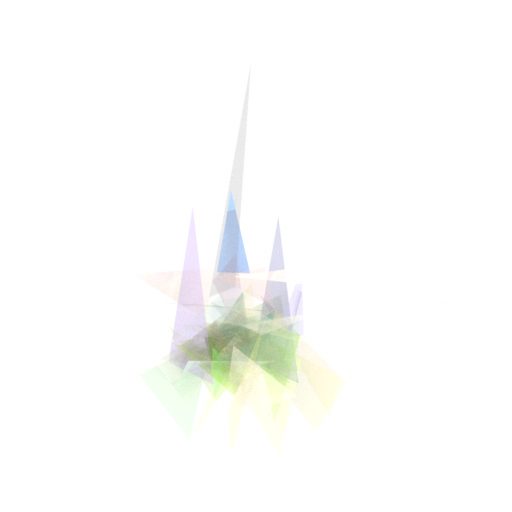

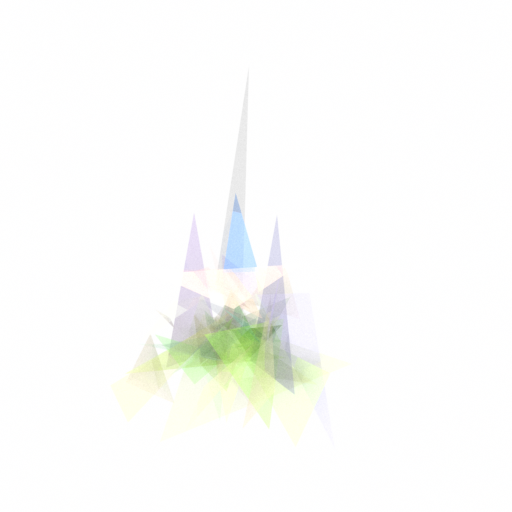

[2:34:27.083789] Iteration      850  ---  best_fitnesses [0.32413775]


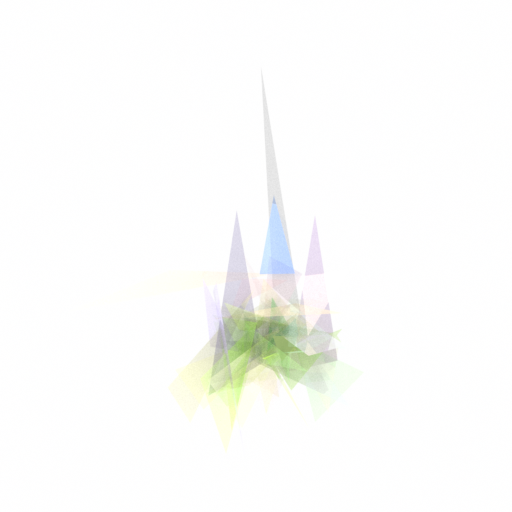

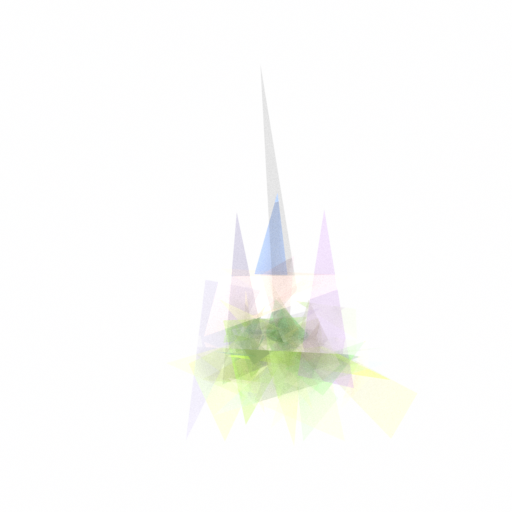

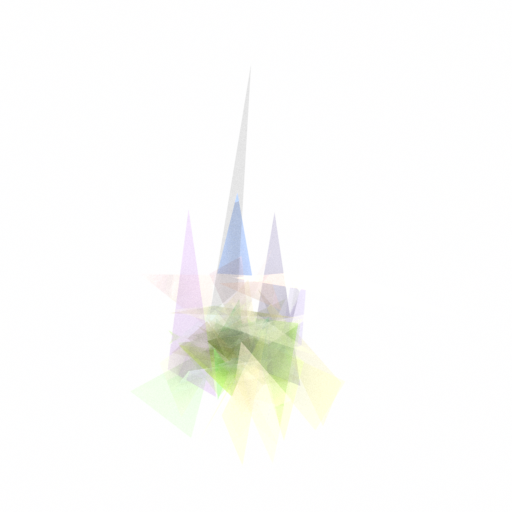

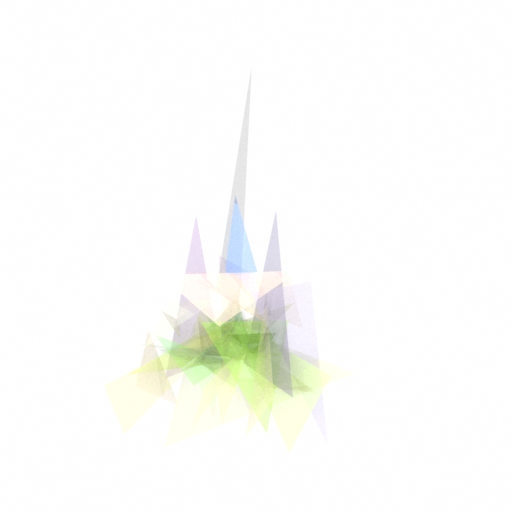

[2:43:18.094643] Iteration      900  ---  best_fitnesses [0.32814205]


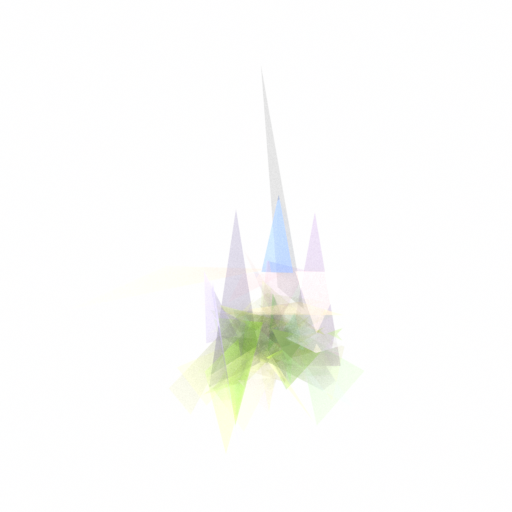

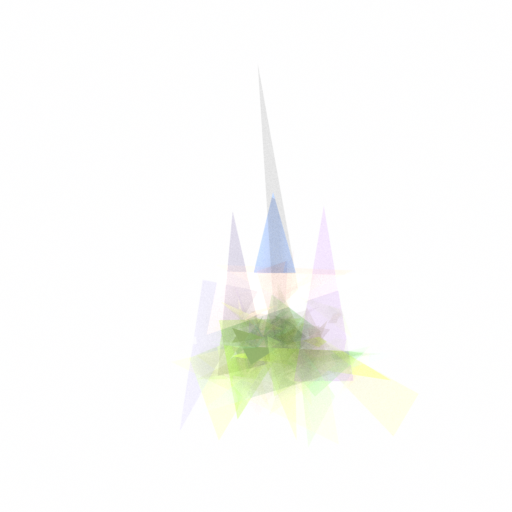

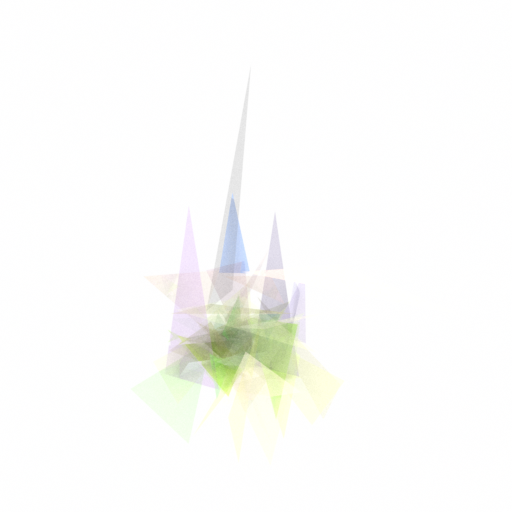

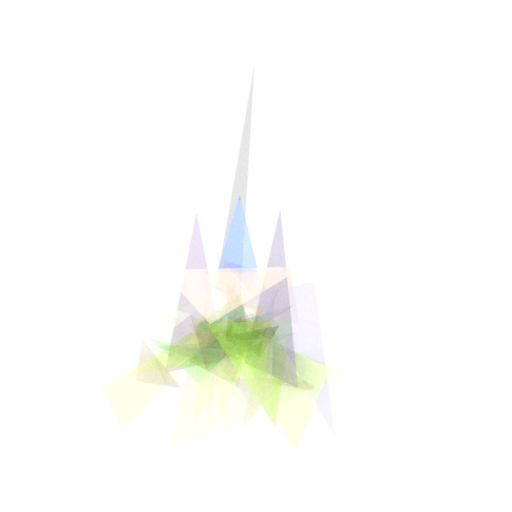

		 new overall best fitness. save to best_*`


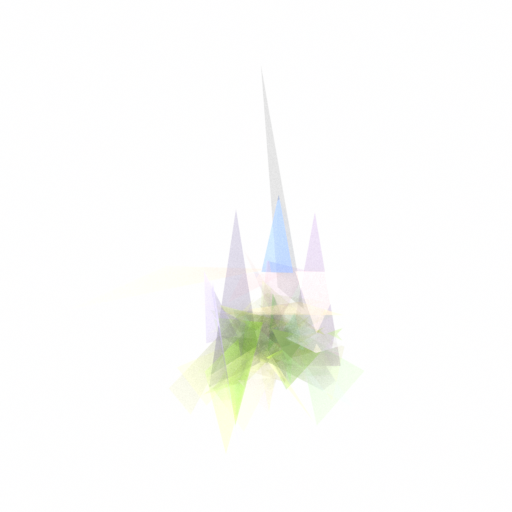

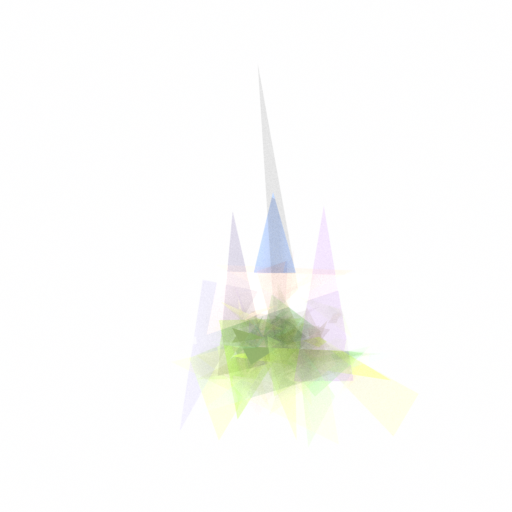

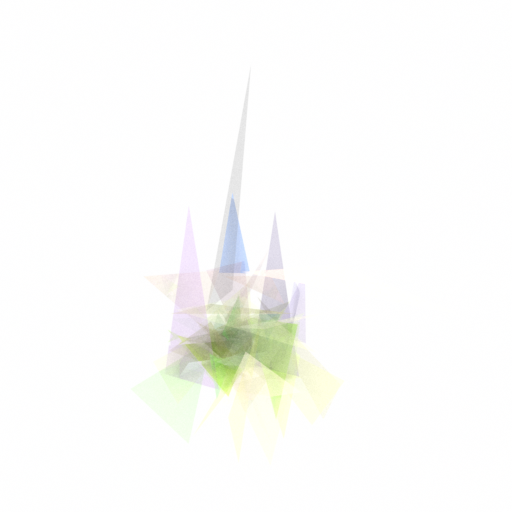

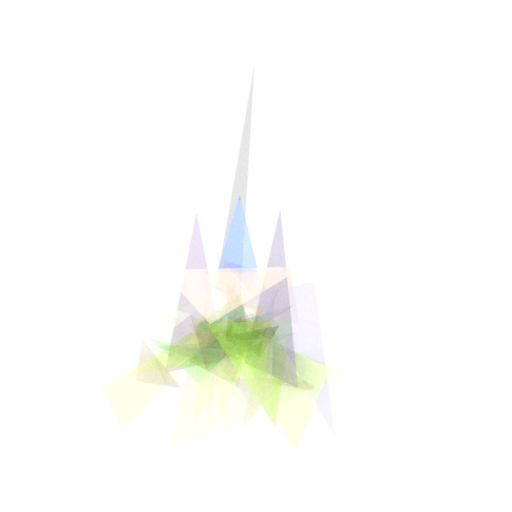

[2:52:12.348859] Iteration      950  ---  best_fitnesses [0.33022624]


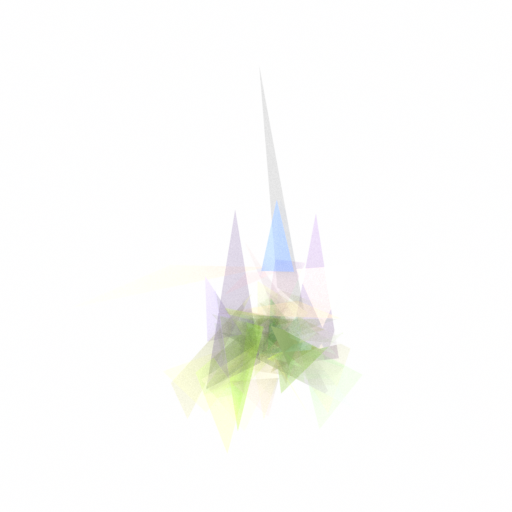

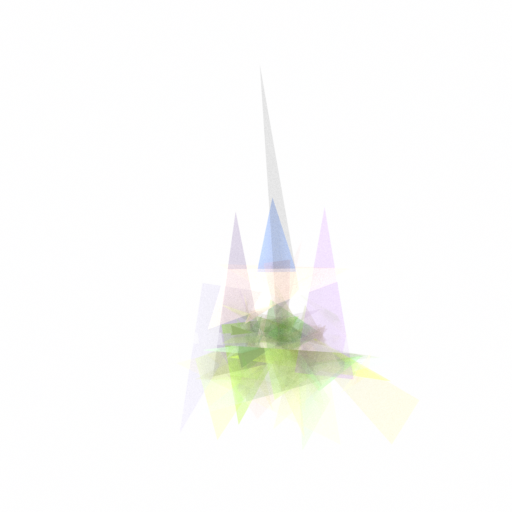

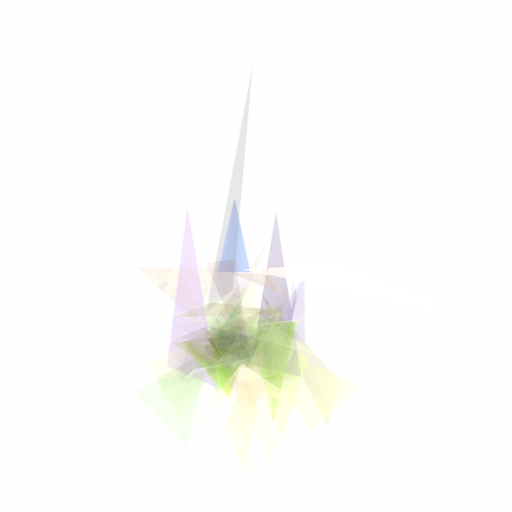

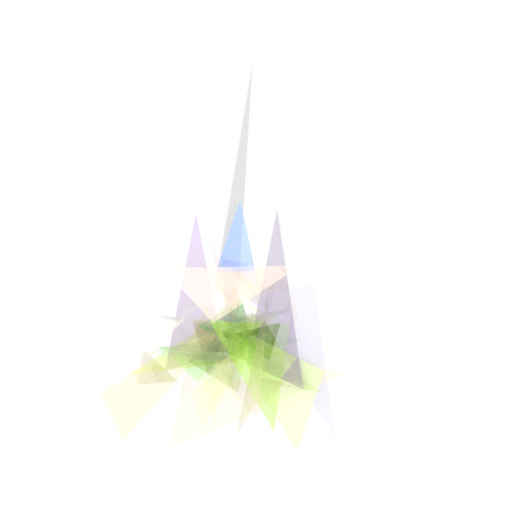

		 new overall best fitness. save to best_*`


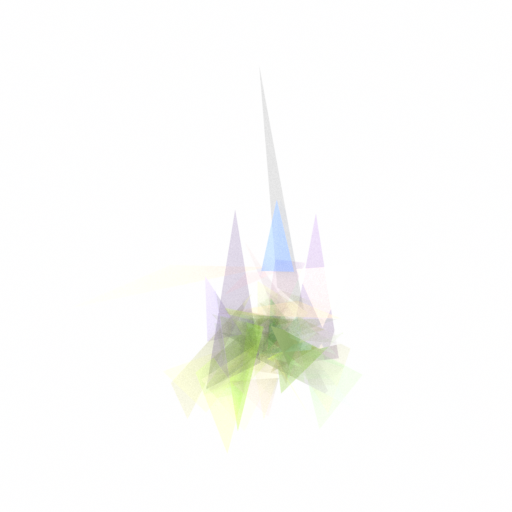

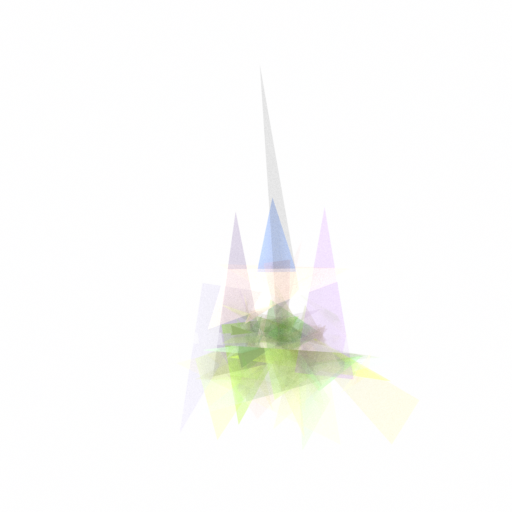

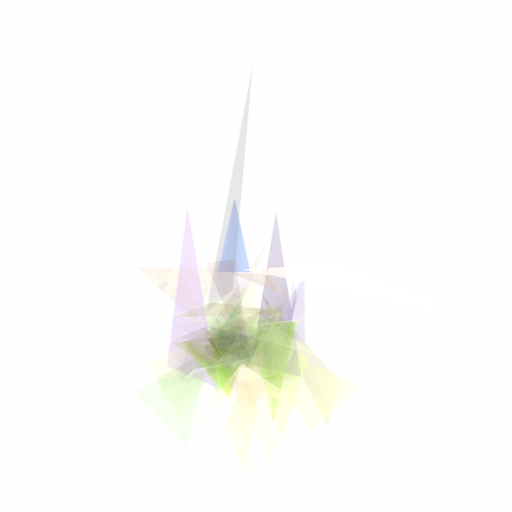

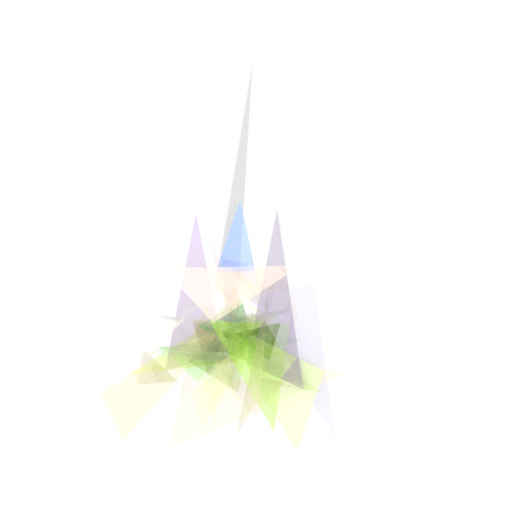

[3:01:09.425884] Iteration     1000  ---  best_fitnesses [0.32838333]


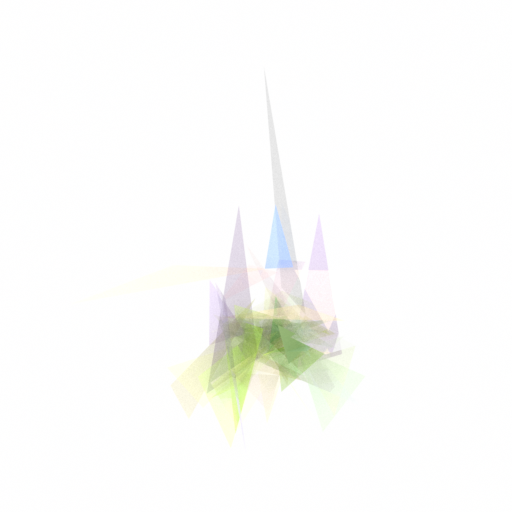

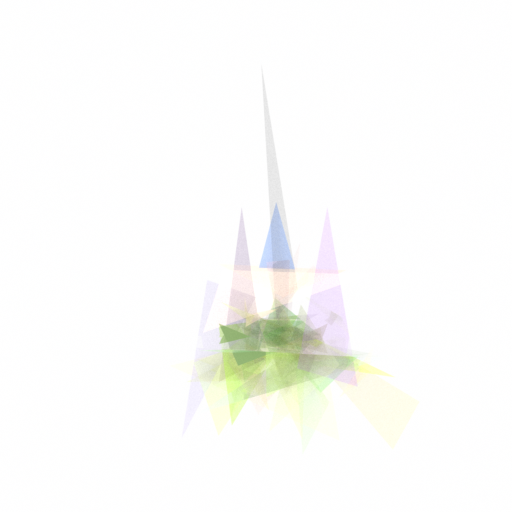

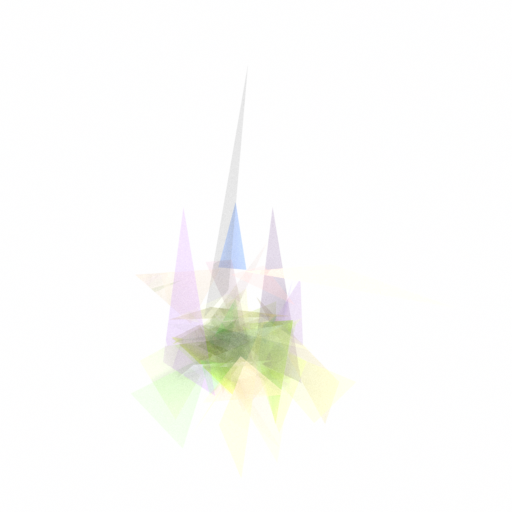

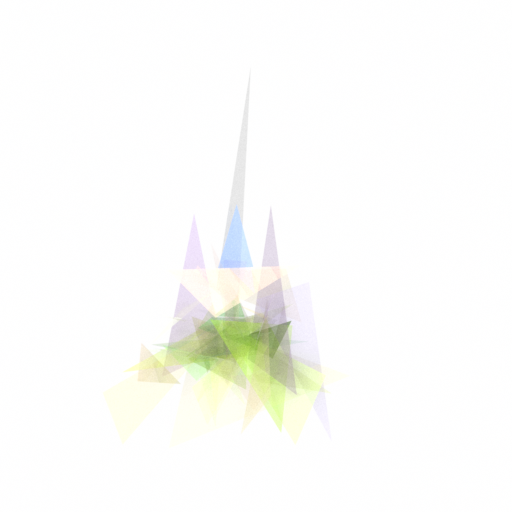

In [ ]:
#@title

main_cfg = build_cfg_from_form()

sig = f'{datetime.datetime.now()}'.replace(' ', '-')
run_dir = f'./es1_run/{sig}'
run_cfg = {
    'sig_aka_time': sig,
    'hostname': platform.node(),
    'gpu': os.environ.get('CUDA_VISIBLE_DEVICES', '<all>'),
}
print('-'* 40)
print(f'# run_dir')
print(run_dir)
print('-'* 40)
print(f'# run_cfg')
pprint.pprint(run_cfg)
print('-'* 40)
print(f'# main_cfg')
pprint.pprint(main_cfg)
print('-'* 40)

os.makedirs(run_dir, exist_ok=True)
with open(f'{run_dir}/_main_cfg.json', 'w') as outfile:
    json.dump(main_cfg, outfile)
    
run_cfg_fn = f'{run_dir}/_run_cfg.json'
with open(run_cfg_fn, 'w') as outfile:
    json.dump(run_cfg, outfile)
    
# unpack from main_cfg
prompts = main_cfg.get('prompts', [])
images = main_cfg.get('images', [])
solver_name = main_cfg['solver_name']
n_population = main_cfg['n_population']
n_iterations = main_cfg['n_iterations']
report_interval = main_cfg['report_interval']
scene_name = main_cfg['scene_name']
scene_hp = main_cfg['scene_hp']
fit_type = main_cfg.get('fit_type', 'prompt')

# real work
assert fit_type in allowed_fit_type

if fit_type == 'prompt':
    feature_manager = es1_lib.FeatureManager()
    emb_prompts = feature_manager.get_text_feature(prompts)
    bitmap_images = None
elif fit_type == 'image':
    feature_manager = None
    emb_prompts = None
    bitmap_images = [load_image_rgb(fn) for fn in images]
    
n_feature = param_size = es1_lib.get_param_size(scene_name=scene_name, scene_hp=scene_hp)

if solver_name == 'PGPE':
    solver = PGPE(
        pop_size=n_population,
        param_size=n_feature,
        optimizer='clipup',
        optimizer_config={'max_speed': 0.15},
    )
elif solver_name == 'CMA_ES':
    solver = CMA_ES_JAX(
        pop_size=n_population,
        param_size=n_feature,
    )
else:
    assert False
    
dispatcher = es1_lib.Dispatcher(environ_override={},)
def render_mediated(**kwargs): 
    return dispatcher.render(**kwargs)
def render_direct(**kwargs):
    return es1_lib.render(**kwargs)

start_time = datetime.datetime.now()
now_time = datetime.datetime.now()
print(f'[{now_time - start_time}] Iteration {"":8s}  --- start')

run_log_fn = f'{run_dir}/_run_log.json'
run_log = dict()
def save_run_log():
    run_log['elapsed_time'] = f'{datetime.datetime.now() - start_time}'
    with open(run_log_fn, 'w') as outfile:
        json.dump(run_log, outfile)
save_run_log()

best_fitnesses_record = 0.0
counter = 0
for iter_ in range(1, 1 + n_iterations):
    solutions = solver.ask()

    fitnesses, _ = render_many_and_calc_fitnesses(
        main_cfg=main_cfg,
        render_fn=render_mediated,
        solutions=solutions,
        feature_manager=feature_manager,
        emb_prompts=emb_prompts,
        bitmap_images=bitmap_images,
    )
    solver.tell(fitnesses)
    if iter_ % report_interval == 0 or iter_ == 1 or iter_ == n_iterations:
        best_solutions = jnp.expand_dims(solver.best_params, axis=0)
        best_fitnesses, aux = render_many_and_calc_fitnesses(
            main_cfg=main_cfg,
            render_fn=render_mediated,
            solutions=best_solutions,
            feature_manager=feature_manager,
            emb_prompts=emb_prompts,
            bitmap_images=bitmap_images,
        )
        now_time = datetime.datetime.now()
        print(f'[{now_time - start_time}] Iteration {iter_:8}  ---  best_fitnesses {best_fitnesses}')

        record_marker = str("%06d"%counter)
        counter += 1
        
        image_list, aux_list = render_many(
            main_cfg=main_cfg,
            render_fn=render_mediated, # since we don't save aux here (aux contains unpicklable mesh), we can use mediated render
            solutions=best_solutions,
            save_aux=False,
            sensor_param_override={'width': 512, 'height': 512},
            render_kwargs={'spp': 1024, },
        )
        for i_image, image in enumerate(image_list):
            display(image)
            image.save(f'{run_dir}/record_canvas_{record_marker}_sensor_{i_image}.png')
        np.save(f'{run_dir}/record_best_solutions_{record_marker}.npy', np.array(best_solutions))
        for aux_name in ['emb_images', 'emb_prompts']:
            if aux_name in aux:
                np.save(f'{run_dir}/record_best_solutions_{record_marker}_aux_{aux_name}.npy', aux[aux_name])
            
        if best_fitnesses > best_fitnesses_record:
            best_fitnesses_record = best_fitnesses
            print(f'\t\t new overall best fitness. save to best_*`')
            
            for i_image, image in enumerate(image_list):
                display(image)
                image.save(f'{run_dir}/best_sensor_{i_image}.png')
                np.save(f'{run_dir}/best_best_solutions.npy', np.array(best_solutions))
                for aux_name in ['emb_images', 'emb_prompts']:
                    if aux_name in aux:
                        np.save(f'{run_dir}/best_best_solutions_aux_{aux_name}.npy', aux[aux_name])
                        
        run_log['iter_'] = f'{iter_}'
        run_log['iter_is_finished'] = f'{iter_ == n_iterations}'
        run_log['best_fitnesses'] = f'{best_fitnesses}'
        run_log['best_fitnesses_record'] = f'{best_fitnesses_record}'
        save_run_log()
        
dispatcher.exit_worker_if_any()


# Visualize

In [ ]:
#@title


def save_images(fn, image_list):
    import shutil
    os.makedirs(fn, exist_ok=True)
    shutil.rmtree(fn)
    os.makedirs(fn, exist_ok=True)
    print(f'Images are saved under {run_dir}/_images')
    for index, f in enumerate(image_list):
        f.save(f'{fn}/{index:06d}.png')
        

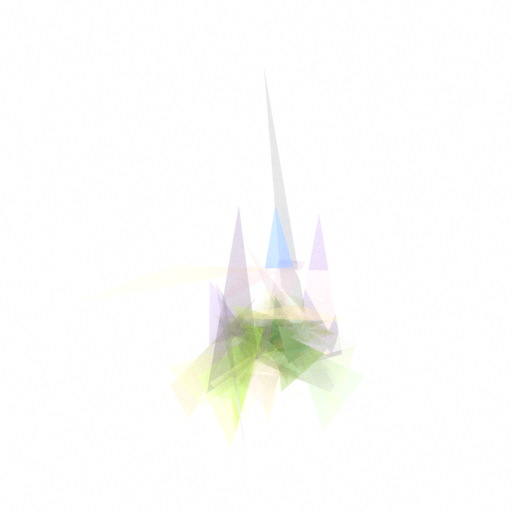

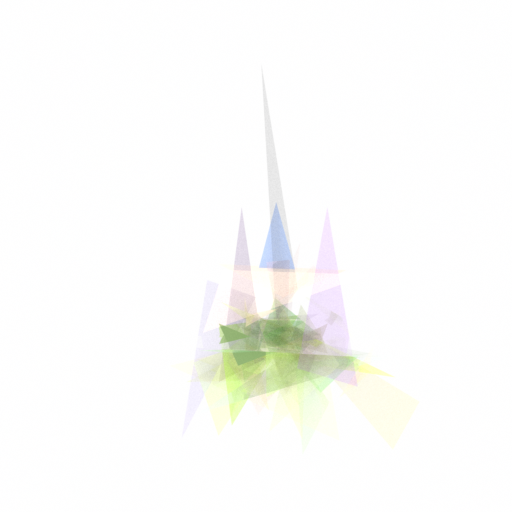

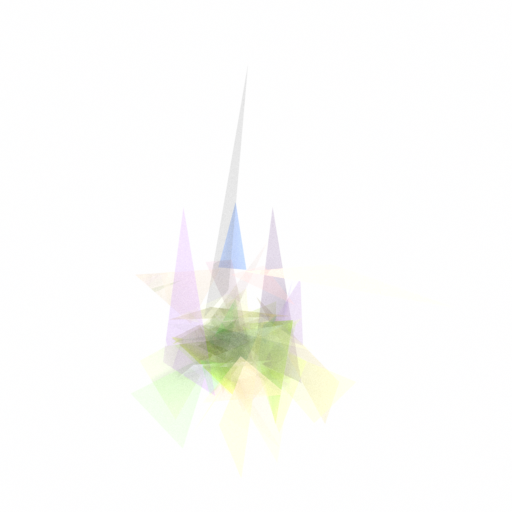

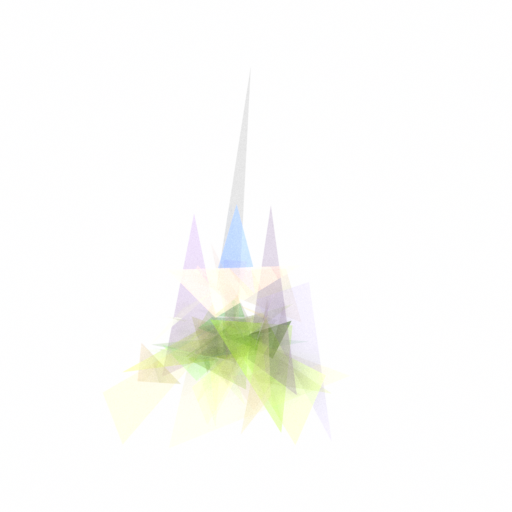

Images are saved under ./es1_run/2023-02-14-07:30:29.152498/_images


In [ ]:
#@title
# ======================================
# Render and save images in high quality
# ======================================

image_list, _ = render_many(
    main_cfg=main_cfg,
    render_fn=render_direct,
    solutions=best_solutions,
    save_aux=False,
    sensor_param_override={'width': 512, 'height': 512},
    render_kwargs={'spp': 1024, },
)


for image in image_list:
    display( image )
save_images(f'{run_dir}/_images', image_list)

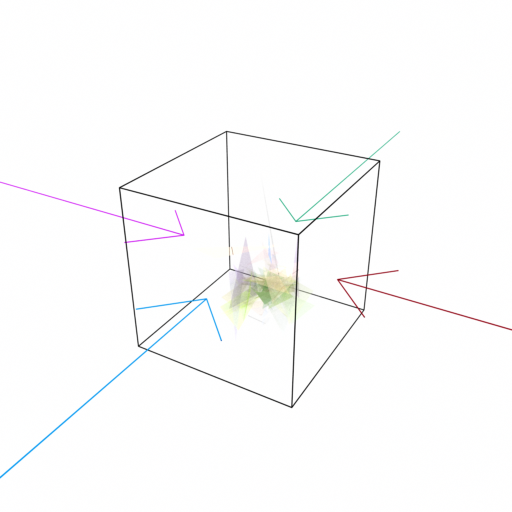

Images are saved under ./es1_run/2023-02-14-07:30:29.152498/_images


In [ ]:
#@title
# ===================================
# Make a Schematic of the whole scene
# including cameras, etc
# ===================================

def render_schematic():
    import mitsuba as mi
    render_fn = render_direct
    
    prompts = main_cfg['prompts']
    sensor_params = main_cfg['sensor_params']
    scene_name = main_cfg['scene_name']
    scene_hp = main_cfg['scene_hp']
    
    viz_sensor_param = {
        'theta': 30, 
        'phi': 30,
        'width': 512, 
        'height': 512,
        'r': 7.,
        'fov': 45,
    }
    
    render_hp={
        'sensor_param': viz_sensor_param,
        'save_aux': True, 
        'render_kwargs': {
            'spp': 1024,
        }
    }
    
    scene_param = best_solutions[0]
    
    obj_image, obj_aux = render_fn(
        scene_name=scene_name,
        scene_hp=scene_hp,
        scene_param=scene_param,
        render_hp=render_hp,
    )
    
    # make a new scene with camera visualized
    mesh_colored = obj_aux['obj']
    
    # color from https://xkcd.com/color/rgb/
    viz_colors_hex = [
        '#069af3', # azure
        '#8c000f', # crimson
        '#10a674', # bluish green
        '#cb00f5', #hot purple
        '#fec615', # golden yellow
        '#fa5ff7' # light magenta
    ]
    hex_to_rgb = lambda _: [
        int(_[1:3], 16) / 255., 
        int(_[3:5], 16) / 255., 
        int(_[5:7], 16) / 255.,
    ]
    viz_colors_rgb = [
        hex_to_rgb(_hex)
        for _hex in viz_colors_hex
    ]
    
    
    def cross_product(a, b):
        ax, ay, az = a
        bx, by, bz = b
        return np.array([ay*bz-az*by, ax*bz-az*bx, ax*by-ay*bx])
    
    def normalize(a):
        return a / np.sqrt((a**2).sum())
    
    n_sensor_params = len(sensor_params)
    
    pipes = {}
    radius = 0.005
    for i in range(n_sensor_params):
        sensor_param = sensor_params[i]
        
        theta = sensor_param['theta']
        phi = sensor_param['phi']
        width = sensor_param.get('width', None)
        height = sensor_param.get('height', None)
        r = sensor_param.get('r', None)
        fov = sensor_param.get('fov', None)
        
        width = width or 256
        height = height or 256
        r = r or 5.0
        fov = fov or 30.0
            
        theta = float(theta) / 180. * np.pi
        phi = float(phi) / 180. * np.pi

        x = np.cos(theta) * np.cos(phi)
        y = np.cos(theta) * np.sin(phi)
        z = np.sin(theta)
        
        r_end = 1.0
        start = np.array([r*x, r*y, r*z])
        end = np.array([r_end*x, r_end*y, r_end*z])
        bsdf = {
            'type': 'twosided',
            'material': {
                'type': 'diffuse',
                'reflectance': {
                    'type': 'rgb',
                    'value': viz_colors_rgb[i],
                },
            },
        }
        pipes[f'pipe_{i}'] = mi.load_dict({
            'type': 'cylinder', 'p0': start, 'p1': end, 
            'radius': radius, 'bsdf': bsdf,
        })
        
        back_norm = normalize(start - end)
        up = np.array([0., 0., 1.])
        side_norm = normalize(cross_product(back_norm, up))
        r_arrow = 0.5
        
        pipes[f'pipe_{i}_arrow_0'] = mi.load_dict({
            'type': 'cylinder', 'p0': end, 'p1': end + r_arrow * (back_norm + side_norm), 
            'radius': radius, 'bsdf': bsdf,
        })
        
        pipes[f'pipe_{i}_arrow_1'] = mi.load_dict({
            'type': 'cylinder', 'p0': end, 'p1': end + r_arrow * (back_norm - side_norm), 
            'radius': radius, 'bsdf': bsdf,
        })
        
        
    box = {}
    for i, (p0, p1) in enumerate([
        [[-1., -1., -1.], [-1., -1., +1.]],
        [[-1., +1., -1.], [-1., +1., +1.]],
        [[+1., -1., -1.], [+1., -1., +1.]],
        [[+1., +1., -1.], [+1., +1., +1.]],
        
        [[-1., +1., -1.], [-1., -1., -1.]],
        [[-1., +1., +1.], [-1., -1., +1.]],
        [[+1., +1., -1.], [+1., -1., -1.]],
        [[+1., +1., +1.], [+1., -1., +1.]],
        
        
        [[-1., -1., -1.], [+1., -1., -1.]],
        [[-1., -1., +1.], [+1., -1., +1.]],
        [[-1., +1., -1.], [+1., +1., -1.]],
        [[-1., +1., +1.], [+1., +1., +1.]],
    ]):    
        box[f'box_frame_{i}'] = mi.load_dict({
            'type': 'cylinder', 'p0': p0, 'p1': p1, 'radius': radius, 
            'bsdf':  {
                'type': 'diffuse',
                'reflectance': {
                    'type': 'rgb',
                    'value': [0., 0., 0.],
                },
            },
        })
        
    scene_base = {
        'type': 'scene',
        'myintegrator': {
            'type': 'path',
            'max_depth': 16,
        },
        'emitter_0': {
            'type': 'constant',
            'radiance': {
                'type': 'spectrum',
                'value': 1.0,
            }
        },
        'triangles': mesh_colored,
    }
    
    
    # with box only
    scene = scene_base.copy()
    for k, v in box.items():
        scene[k] = v
        
    #for k, v in pipes.items():
    #    scene[k] = v
    
    scene = mi.load_dict(scene)
    # print(scene)
    sensor_fn = es1_lib.scene0_sensor_fn
    viz_sensor = sensor_fn(
        theta = viz_sensor_param['theta'], 
        phi = viz_sensor_param['phi'],
        width = viz_sensor_param.get('width', None),
        height = viz_sensor_param.get('height', None),
        r = viz_sensor_param.get('r', None),
        fov = viz_sensor_param.get('fov', None),
    )
    
    image_mi = mi.render(scene, sensor=viz_sensor, **render_hp['render_kwargs'])
    image_pil = Image.fromarray(np.uint8( np.clip(np.array(mi.Bitmap(image_mi)) * 255., 0., 255.) ) )
    box_image = image_pil
    
    # with box & arrows
    scene = scene_base.copy()
    for k, v in box.items():
        scene[k] = v    
    for k, v in pipes.items():
        scene[k] = v
    
    scene = mi.load_dict(scene)
    # print(scene)
    sensor_fn = es1_lib.scene0_sensor_fn
    viz_sensor = sensor_fn(
        theta = viz_sensor_param['theta'], 
        phi = viz_sensor_param['phi'],
        width = viz_sensor_param.get('width', None),
        height = viz_sensor_param.get('height', None),
        r = viz_sensor_param.get('r', None),
        fov = viz_sensor_param.get('fov', None),
    )
    
    image_mi = mi.render(scene, sensor=viz_sensor, **render_hp['render_kwargs'])
    image_pil = Image.fromarray(np.uint8( np.clip(np.array(mi.Bitmap(image_mi)) * 255., 0., 255.) ) )
    all_image = image_pil
    
                                         
    return all_image,
    
images = render_schematic()
for image in images:
    display( image )

save_images(f'{run_dir}/_semantics', image_list)


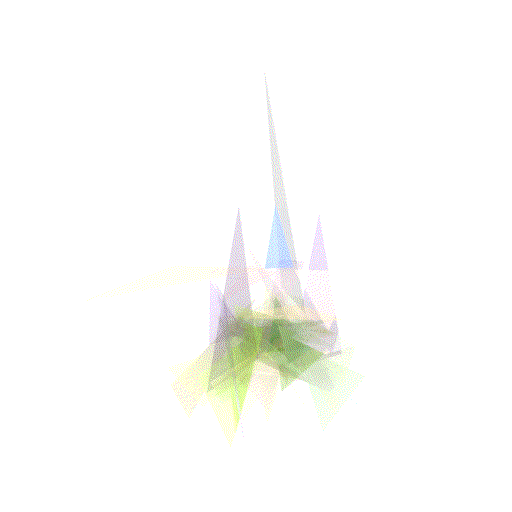

In [ ]:
#@title
# =============================
# Render a 360 degree animation
# =============================


video_frames = []
for phi in np.linspace(0.0, 360, 36):
    scene_param = best_solutions[0]
    sensor_param = {
        'theta': 0, 
        'phi': phi,
        'width': 512, 
        'height': 512
    }
    render_fn = render_direct
    render_kwargs={'spp': 1024, }
    render_hp={'sensor_param': sensor_param, 'save_aux': False, 'render_kwargs':render_kwargs}
            
    image, _ = render_fn(
        scene_name=scene_name,
        scene_hp=scene_hp,
        scene_param=scene_param,
        render_hp=render_hp,
    )
    video_frames.append( image )

def save_gif(fn, frames):
    # frames = frames + frames[::-1]
    frames[0].save(
        fn,
        save_all=True, 
        append_images=video_frames[1:],
        loop=0xFFFF,  # ~= loop forever
    ) 
    
def display_gif(fn):
    import base64
    from IPython.display import HTML
    b64 = base64.b64encode(open(fn,'rb').read()).decode('ascii')
    display(HTML(f'<img src="data:image/gif;base64,{b64}" />'))
    
save_gif(f'{run_dir}/_viz.gif', video_frames)
display_gif(f'{run_dir}/_viz.gif') 

In [ ]:
#@title
import moviepy.editor as mpy

def save_mp4(fn, frames, fps=12):
    def make_frame(t):
        #print(f't={t}, t*fps={t*fps}, int(t*fps)={int(t*fps)}')
        return np.asarray(frames[int(t*fps)]) # 8-bit RGB array
    
    #frames = frames + frames[::-1] # duplicate
    
    frames_n = len(frames)
    duration = (frames_n-1) * 1.0 / fps
    #print(f'frames_n={frames_n}, duration={duration}, fps={fps}')
    clip = mpy.VideoClip(make_frame, duration=duration)
    clip.set_fps(fps)
    #print(f'fps={fps}')
    clip.write_videofile(fn, fps=fps, codec='libx264', bitrate='1M',  verbose=False) # ffmpeg's default bitrate is 200k
    
def display_mp4(fn):
    import base64
    from IPython.display import HTML
    b64 = base64.b64encode(open(fn,'rb').read()).decode('ascii')
    # see http://www.iandevlin.com/blog/2012/09/html5/html5-media-and-data-uri/
    display(HTML(f'''
        <video controls autoplay loop> 
            <source src="data:image/mp4;base64,{b64}" type="video/mp4"> 
        </video>'''
    ))

save_mp4(f'{run_dir}/_viz.mp4', video_frames)
display_mp4(f'{run_dir}/_viz.mp4')

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)4005888/45929032 bytes (8.7%)8142848/45929032 bytes (17.7%)12378112/45929032 bytes (27.0%)16719872/45929032 bytes (36.4%)21069824/45929032 bytes (45.9%)25395200/45929032 bytes (55.3%)29712384/45929032 bytes (64.7%)33914880/45929032 bytes (73.8%)38207488/45929032 bytes (83.2%)42500096/45929032 bytes (92.5%)45929032/45929032 bytes (100.0%)
  Done
File saved as /root/.imageio/ffmpeg/ffmpeg-linux64-v3.3.1.


 97%|█████████▋| 35/36 [00:00<00:00, 410.80it/s]
